In [1]:
#!pip install --upgrade pip
#!pip install graphviz
#!pip install dask
#!pip install toolz
#!pip install cloudpickle
#!pip install folium
#!pip install gpxpy

# Importing Necessary Libraries

In [2]:
import dask.dataframe as dd
import warnings
warnings.filterwarnings("ignore")

/Users/rolex/anaconda3/lib/python3.11/site-packages/dask/dataframe/_pyarrow_compat.py:21: UserWarning: You are using pyarrow version 11.0.0 which is known to be insecure. See https://www.cve.org/CVERecord?id=CVE-2023-47248 for further details. Please upgrade to pyarrow>=14.0.1 or install pyarrow-hotfix to patch your current version.
  warnings.warn(
/Users/rolex/anaconda3/lib/python3.11/site-packages/dask/dataframe/__init__.py:42: FutureWarning: 
Dask dataframe query planning is disabled because dask-expr is not installed.

You can install it with `pip install dask[dataframe]` or `conda install dask`.
This will raise in a future version.

  warnings.warn(msg, FutureWarning)


In [3]:
import pandas as pd
import numpy as np
import folium
from IPython.display import IFrame
import datetime
import time
import matplotlib
matplotlib.use('nbagg')
import matplotlib.pyplot as plt
import seaborn as sns
from matplotlib import rcParams
import gpxpy.geo
from sklearn.cluster import MiniBatchKMeans, KMeans
import math
import scipy
import pickle
import os
from sklearn.cluster import MiniBatchKMeans
import scipy.stats as stats
import xgboost as xgb
from sklearn.ensemble import RandomForestRegressor
from sklearn.metrics import mean_squared_error
from sklearn.metrics import mean_absolute_error
import warnings
warnings.filterwarnings("ignore")

# Reading the Dataset & Features

In [4]:
df = dd.read_csv('/Users/rolex/Desktop/Dissertation/Data/yellow_tripdata_2015-01.csv.zip')

In [5]:
df.head()

,VendorID,tpep_pickup_datetime,tpep_dropoff_datetime,passenger_count,trip_distance,pickup_longitude,pickup_latitude,RateCodeID,store_and_fwd_flag,dropoff_longitude,dropoff_latitude,payment_type,fare_amount,extra,mta_tax,tip_amount,tolls_amount,improvement_surcharge,total_amount
0,2,2015-01-15 19:05:39,2015-01-15 19:23:42,1,1.59,-73.993896,40.750111,1,N,-73.974785,40.750618,1,12.0,1.0,0.5,3.25,0.0,0.3,17.05
1,1,2015-01-10 20:33:38,2015-01-10 20:53:28,1,3.30,-74.001648,40.724243,1,N,-73.994415,40.759109,1,14.5,0.5,0.5,2.00,0.0,0.3,17.80
2,1,2015-01-10 20:33:38,2015-01-10 20:43:41,1,1.80,-73.963341,40.802788,1,N,-73.951820,40.824413,2,9.5,0.5,0.5,0.00,0.0,0.3,10.80
3,1,2015-01-10 20:33:39,2015-01-10 20:35:31,1,0.50,-74.009087,40.713818,1,N,-74.004326,40.719986,2,3.5,0.5,0.5,0.00,0.0,0.3,4.80
4,1,2015-01-10 20:33:39,2015-01-10 20:52:58,1,3.00,-73.971176,40.762428,1,N,-74.004181,40.742653,2,15.0,0.5,0.5,0.00,0.0,0.3,16.30


In [6]:
df.fare_amount.sum().compute()

151785085.34000006

In [7]:
df.columns

Index(['VendorID', 'tpep_pickup_datetime', 'tpep_dropoff_datetime',
       'passenger_count', 'trip_distance', 'pickup_longitude',
       'pickup_latitude', 'RateCodeID', 'store_and_fwd_flag',
       'dropoff_longitude', 'dropoff_latitude', 'payment_type', 'fare_amount',
       'extra', 'mta_tax', 'tip_amount', 'tolls_amount',
       'improvement_surcharge', 'total_amount'],
      dtype='object')

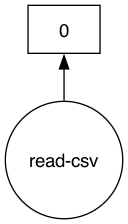

In [8]:
df.visualize()

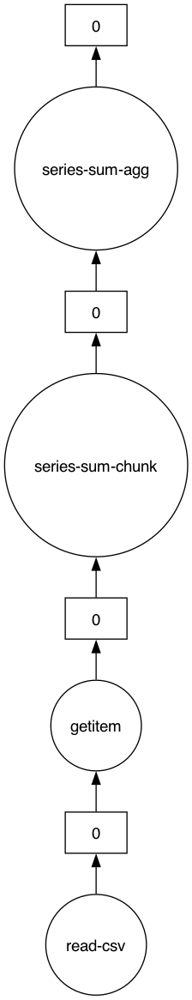

In [9]:
df.fare_amount.sum().visualize()

# Data Cleaning

In [10]:
df.head(5)

,VendorID,tpep_pickup_datetime,tpep_dropoff_datetime,passenger_count,trip_distance,pickup_longitude,pickup_latitude,RateCodeID,store_and_fwd_flag,dropoff_longitude,dropoff_latitude,payment_type,fare_amount,extra,mta_tax,tip_amount,tolls_amount,improvement_surcharge,total_amount
0,2,2015-01-15 19:05:39,2015-01-15 19:23:42,1,1.59,-73.993896,40.750111,1,N,-73.974785,40.750618,1,12.0,1.0,0.5,3.25,0.0,0.3,17.05
1,1,2015-01-10 20:33:38,2015-01-10 20:53:28,1,3.30,-74.001648,40.724243,1,N,-73.994415,40.759109,1,14.5,0.5,0.5,2.00,0.0,0.3,17.80
2,1,2015-01-10 20:33:38,2015-01-10 20:43:41,1,1.80,-73.963341,40.802788,1,N,-73.951820,40.824413,2,9.5,0.5,0.5,0.00,0.0,0.3,10.80
3,1,2015-01-10 20:33:39,2015-01-10 20:35:31,1,0.50,-74.009087,40.713818,1,N,-74.004326,40.719986,2,3.5,0.5,0.5,0.00,0.0,0.3,4.80
4,1,2015-01-10 20:33:39,2015-01-10 20:52:58,1,3.00,-73.971176,40.762428,1,N,-74.004181,40.742653,2,15.0,0.5,0.5,0.00,0.0,0.3,16.30


### Pickup Latitude and Longitude

According to the source, New York is bounded by the geographical coordinates (lat,long) 40.5774, -74.15) & (40.9176, -73.7004). As a result, we only take into account coordinates that begin in New York, and we thus do not examine any coordinates that are outside of these ranges.

In [11]:
#bounding box for New York City
bbox_ny = {
    'min_lon': -74.15,
    'max_lon': -73.7004,
    'min_lat': 40.5774,
    'max_lat': 40.9176
}

#outlier pickup locations outside the bounding box
outlier_conditions = (
    (df.pickup_longitude <= bbox_ny['min_lon']) |
    (df.pickup_latitude <= bbox_ny['min_lat']) |
    (df.pickup_longitude >= bbox_ny['max_lon']) |
    (df.pickup_latitude >= bbox_ny['max_lat'])
)
outlier_locations = df[outlier_conditions].compute()

#Folium map centered around New York City
nyc_center = [40.734695, -73.990372]  # Central coordinates for NYC
map_nyc = folium.Map(location=nyc_center, zoom_start=12, tiles='OpenStreetMap')

#sample of outlier locations for plotting
#Only the first 100 outliers will be displayed on the map; it will take a long time to plot every outlier.
sample_size = 10000
sampled_outliers = outlier_locations.head(sample_size)

#markers for the sampled outliers
for _, row in sampled_outliers.iterrows():
    lat, lon = row['pickup_latitude'], row['pickup_longitude']
    if lat != 0:  # latitude is non-zero
        folium.Marker(location=[lat, lon]).add_to(map_nyc)

# map to an HTML file
map_html_path = 'nyc_outliers_map.html'
map_nyc.save(map_html_path)

# saved map in my Notebook using IFrame
display(IFrame(src=map_html_path, width=800, height=600))


##### Observation: As we can see above, certain spots are located close outside the boundary, while other points are in Canada, Mexico, or South America.

### Dropoff Latitude and Longitude

In [12]:
# bounding box for New York City
bbox_ny = {
    'min_lon': -74.15,
    'max_lon': -73.7004,
    'min_lat': 40.5774,
    'max_lat': 40.9176
}

# dropoff locations outside the bounding box
#all the points outside of New York City's bounding box will be gathered and sent to outlier_locations.
dropoff_outlier_conditions = (
    (df.dropoff_longitude <= bbox_ny['min_lon']) |
    (df.dropoff_latitude <= bbox_ny['min_lat']) |
    (df.dropoff_longitude >= bbox_ny['max_lon']) |
    (df.dropoff_latitude >= bbox_ny['max_lat'])
)
dropoff_outliers = df[dropoff_outlier_conditions].compute()

#Folium map centered around New York City
nyc_center = [40.734695, -73.990372]  # Central coordinates for NYC
map_nyc_dropoff = folium.Map(location=nyc_center, zoom_start=12, tiles='OpenStreetMap')

# dropoff outliers for plotting
sample_size = 10000
sampled_dropoffs = dropoff_outliers.head(sample_size)

#markers for sampled dropoff outliers
for _, row in sampled_dropoffs.iterrows():
    lat, lon = row['dropoff_latitude'], row['dropoff_longitude']
    if lat != 0:  # Ensure latitude is non-zero
        folium.Marker(location=[lat, lon]).add_to(map_nyc_dropoff)

#map to an HTML file
dropoff_map_html_path = 'nyc_dropoff_outliers_map.html'
map_nyc_dropoff.save(dropoff_map_html_path)

# saved map in my Notebook using IFrame
display(IFrame(src=dropoff_map_html_path, width=800, height=600))

##### Observation: These findings align with the results of the analysis of pickup latitude and longitude.

### Trip-Duration

##### NYC Taxi & Limousine Commission regulations state that a trip may last no more than 12 hours in a 24-hour period.

In [13]:
#To determine duration (trip time) and speed, the timestamps are translated to unix. Additionally, pickup times in unix are used for binning. 
#We first convert the time string in our data—which is in the format "YYYY-MM-DD HH:MM:SS"—to Python time format and then to 
#Unix time stamp format https://stackoverflow.com/a/27914405 is the reference link.
# Function to convert timestamp strings to Unix time
def timestamp_to_unix(timestamp_str):
    """
    Convert a timestamp string in the format 'YYYY-MM-DD HH:MM:SS' to a Unix timestamp.
    """
    return time.mktime(datetime.datetime.strptime(timestamp_str, "%Y-%m-%d %H:%M:%S").timetuple())

# we return a data frame which contains the columns
# 1.'passenger_count' 
# 2.'trip_distance' 
# 3.'pickup_longitude' 
# 4.'pickup_latitude' 
# 5.'dropoff_longitude' 
# 6.'dropoff_latitude' 
# 7.'total_amount' : total fair that was paid
# 8.'trip_times' : duration of each trip
# 9.'pickup_times : pickup time converted into unix time 
# 10.'Speed' : velocity of each trip

# Function to calculate trip durations and speeds
def calculate_trip_details(trip_df):
    """
    Compute trip details including trip duration, pickup time in Unix, and speed.
    
    Parameters:
    month_df (DataFrame): Input dataframe with trip data.
    
    Returns:
    DataFrame: DataFrame with additional columns for trip duration, pickup time, and speed.
    """
    # pickup and dropoff times
    times_df = trip_df[['tpep_pickup_datetime', 'tpep_dropoff_datetime']].compute()

    # Convert times to Unix timestamps
    pickup_unix = [timestamp_to_unix(ts) for ts in times_df['tpep_pickup_datetime']]
    dropoff_unix = [timestamp_to_unix(ts) for ts in times_df['tpep_dropoff_datetime']]

    # Compute trip durations in minutes
    trip_durations = (np.array(dropoff_unix) - np.array(pickup_unix)) / 60.0

    result_df = trip_df[['passenger_count', 'trip_distance', 'pickup_longitude', 'pickup_latitude', 
                          'dropoff_longitude', 'dropoff_latitude', 'total_amount']].compute()
    
    # new columns for trip duration, pickup time, and speed
    result_df['trip_duration'] = trip_durations
    result_df['pickup_unix'] = pickup_unix
    result_df['speed_mph'] = 60 * (result_df['trip_distance'] / result_df['trip_duration'])
    
    return result_df

frame_with_trip_details = calculate_trip_details(df)


frame_with_trip_details.head()

,passenger_count,trip_distance,pickup_longitude,pickup_latitude,dropoff_longitude,dropoff_latitude,total_amount,trip_duration,pickup_unix,speed_mph
0,1,1.59,-73.993896,40.750111,-73.974785,40.750618,17.05,18.050000,1.421349e+09,5.285319
1,1,3.30,-74.001648,40.724243,-73.994415,40.759109,17.80,19.833333,1.420922e+09,9.983193
2,1,1.80,-73.963341,40.802788,-73.951820,40.824413,10.80,10.050000,1.420922e+09,10.746269
3,1,0.50,-74.009087,40.713818,-74.004326,40.719986,4.80,1.866667,1.420922e+09,16.071429
4,1,3.00,-73.971176,40.762428,-74.004181,40.742653,16.30,19.316667,1.420922e+09,9.318378


<IPython.core.display.Javascript object>


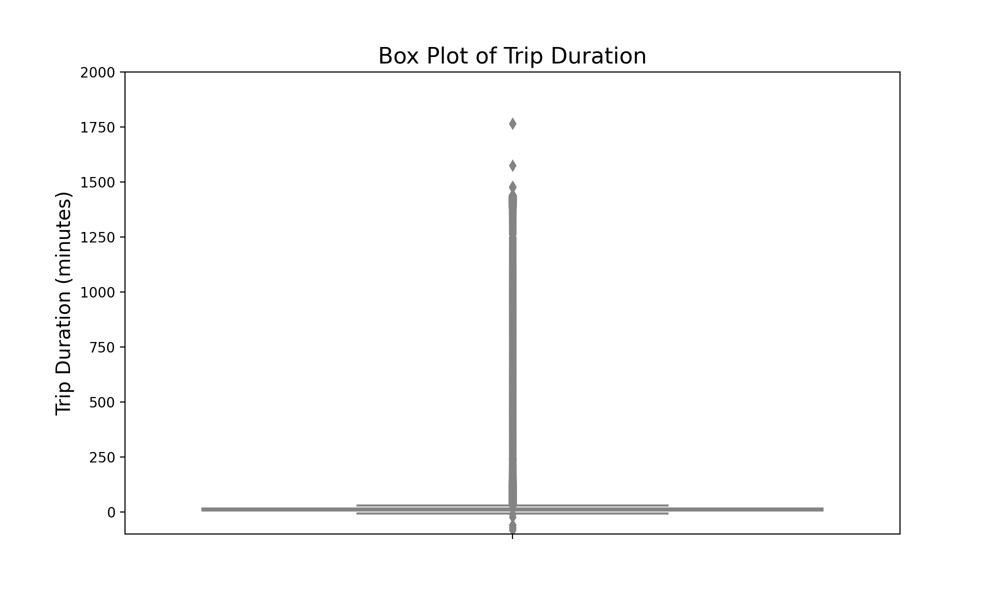

In [14]:
#box plot to visualize the distribution and outliers in trip times
## The skewed box plot indicates that there are outliers. 
plt.figure(figsize=(10, 6))
ax = sns.boxplot(data=frame_with_trip_details, y='trip_duration', palette='coolwarm')
ax.set_ylim(-100, 2000)
plt.title('Box Plot of Trip Duration', fontsize=16)
plt.ylabel('Trip Duration (minutes)', fontsize=14)
plt.show()

In [15]:
#calculating 0-100th percentile to find the correct percentile value for removal of outliers
# sort the 'trip_duration' data
trip_duration_values = frame_with_trip_details["trip_duration"].values
sorted_trip_duration = np.sort(trip_duration_values)

# percentiles from 0 to 90 in steps of 10
percentiles_list = range(0, 100, 10)
for percentile in percentiles_list:
    index = int(len(sorted_trip_duration) * (percentile / 100))
    percentile_value = sorted_trip_duration[index]
    print(f"{percentile}th percentile value: {percentile_value}")

# maximum value (100th percentile)
print("100th percentile value:", sorted_trip_duration[-1])

0th percentile value: -1211.0166666666667
10th percentile value: 3.8333333333333335
20th percentile value: 5.383333333333334
30th percentile value: 6.816666666666666
40th percentile value: 8.3
50th percentile value: 9.95
60th percentile value: 11.866666666666667
70th percentile value: 14.283333333333333
80th percentile value: 17.633333333333333
90th percentile value: 23.45
100th percentile value: 548555.6333333333


In [16]:
# 'trip_duration' column to a NumPy array and sort it
trip_duration_array = frame_with_trip_details["trip_duration"].values
sorted_duration = np.sort(trip_duration_array)

#range of percentiles 
percentile_range = range(90, 100)


for percentile in percentile_range:
    index = int(len(sorted_duration) * (percentile / 100.0))
    percentile_value = sorted_duration[index]
    print(f"{percentile}th percentile value: {percentile_value}")

# value at the 100th percentile
highest_value = sorted_duration[-1]
print("100th percentile value:", highest_value)


90th percentile value: 23.45
91th percentile value: 24.35
92th percentile value: 25.383333333333333
93th percentile value: 26.55
94th percentile value: 27.933333333333334
95th percentile value: 29.583333333333332
96th percentile value: 31.683333333333334
97th percentile value: 34.46666666666667
98th percentile value: 38.71666666666667
99th percentile value: 46.75
100th percentile value: 548555.6333333333


In [17]:
# Filter the DataFrame to include only trips with durations between 1 and 720 minutes
filtered_durations = frame_with_trip_details.query('trip_duration > 1 and trip_duration < 720')
frame_with_trip_details_filtered = filtered_durations


<IPython.core.display.Javascript object>


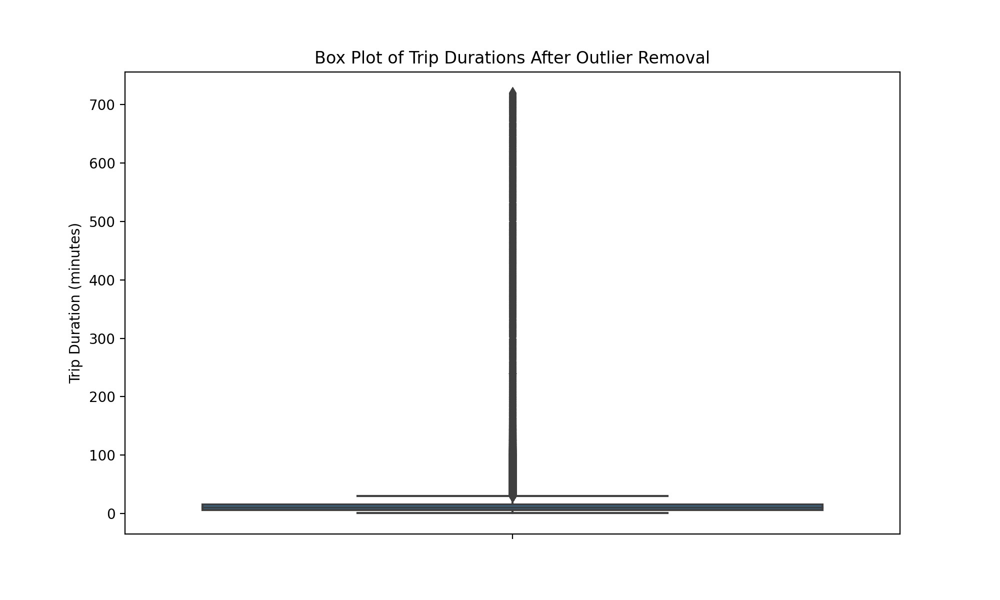

In [18]:
# box plot to visualize trip duration in the filtered DataFrame
fig, ax = plt.subplots(figsize=(10, 6))
sns.boxplot(y="trip_duration", data=frame_with_trip_details_filtered, ax=ax)
ax.set_title("Box Plot of Trip Durations After Outlier Removal")
ax.set_ylabel("Trip Duration (minutes)")
plt.show()

##### PDF of trip duration after otlier removal (probability density function)

<IPython.core.display.Javascript object>


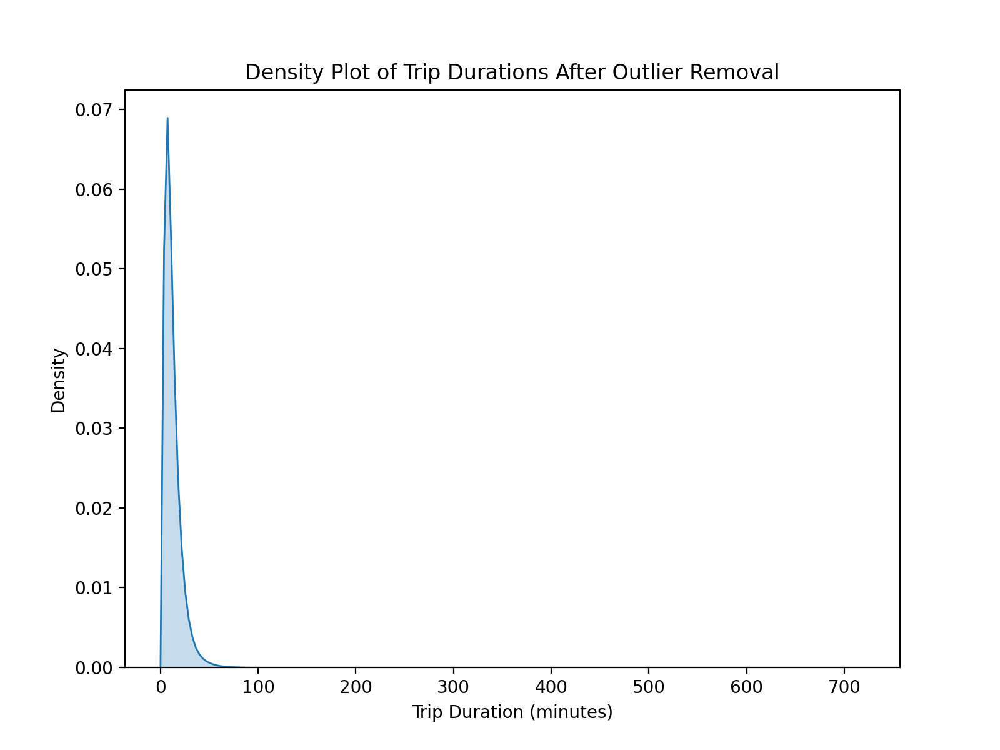

In [19]:
#figure and axis for the plot
fig, ax = plt.subplots(figsize=(8, 6))

#density estimate of trip_duration
sns.kdeplot(data=frame_with_trip_details_filtered, x="trip_duration", ax=ax, fill=True)
ax.set_title("Density Plot of Trip Durations After Outlier Removal")
ax.set_xlabel("Trip Duration (minutes)")
ax.set_ylabel("Density")
plt.show()

<IPython.core.display.Javascript object>


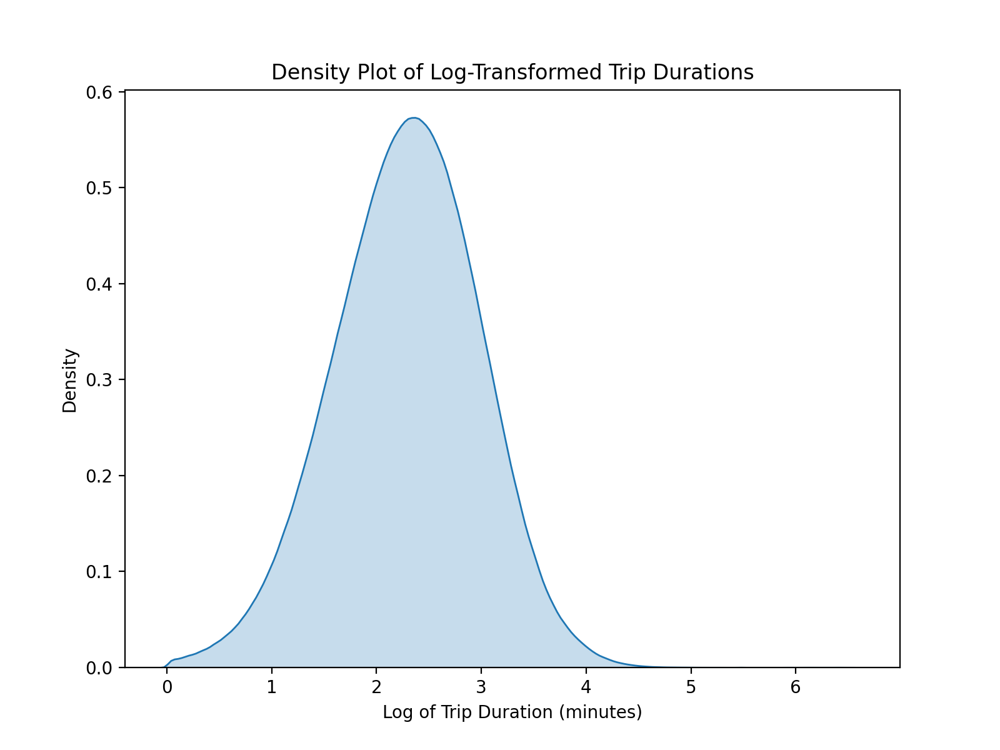

In [20]:
# log-transformed trip_duration
frame_with_trip_details_filtered['log_trip_duration'] = np.log(frame_with_trip_details_filtered['trip_duration'])

plt.figure(figsize=(8, 6))

# PDF of log-transformed trip times
sns.kdeplot(data=frame_with_trip_details_filtered, x="log_trip_duration", fill=True)
plt.title("Density Plot of Log-Transformed Trip Durations")
plt.xlabel("Log of Trip Duration (minutes)")
plt.ylabel("Density")
plt.show()

<IPython.core.display.Javascript object>


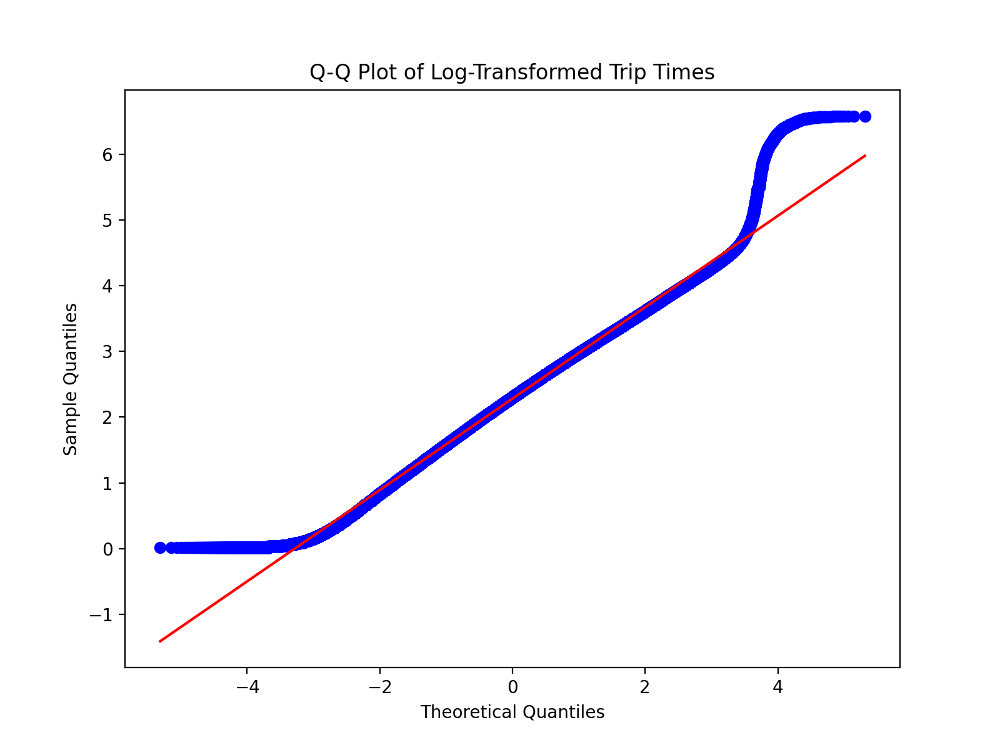

In [21]:
#Q-Q plot to check for log-normal distribution
fig, ax = plt.subplots(figsize=(8, 6))
stats.probplot(frame_with_trip_details_filtered['log_trip_duration'], dist="norm", plot=ax)
ax.set_title("Q-Q Plot of Log-Transformed Trip Times")
ax.set_xlabel("Theoretical Quantiles")
ax.set_ylabel("Sample Quantiles")
plt.show()

### Speed

<IPython.core.display.Javascript object>


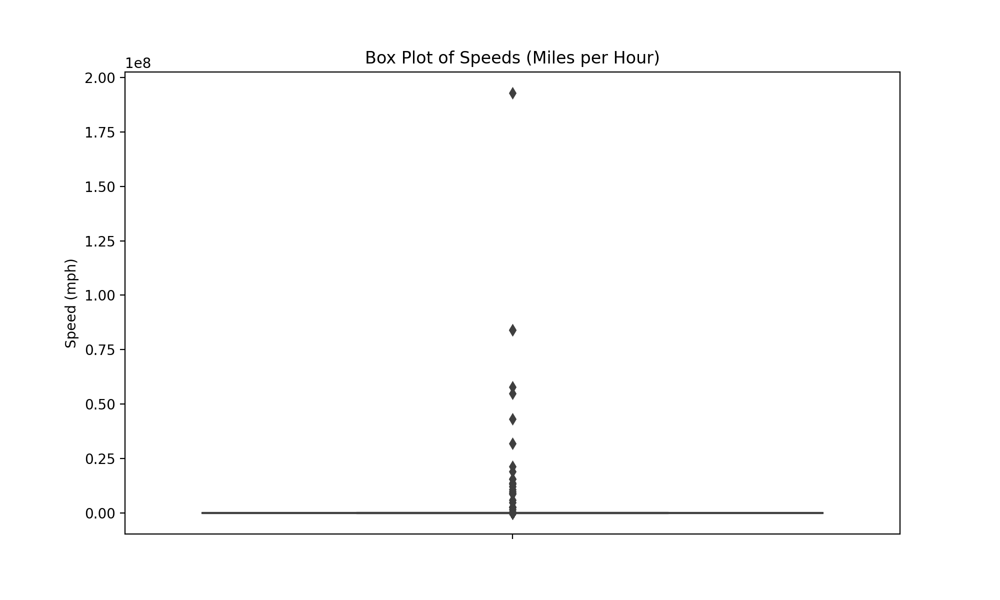

In [22]:
# When trip duration outliers are eliminated, look for any remaining outliers in the data.
# speed in miles per hour
frame_with_trip_details_filtered['speed_mph'] = 60 * (frame_with_trip_details_filtered['trip_distance'] / frame_with_trip_details_filtered['trip_duration'])
plt.figure(figsize=(10, 6))
sns.boxplot(y='speed_mph', data=frame_with_trip_details_filtered)
plt.title('Box Plot of Speeds (Miles per Hour)')
plt.ylabel('Speed (mph)')
plt.show()

In [23]:
#speed values at each percntile 0,10,20,30,40,50,60,70,80,90,100 
percentiles = np.arange(0, 101, 10)

# sort speed values
speed_values = frame_with_trip_details_filtered["speed_mph"].values
sorted_speeds = np.sort(speed_values)

percentile_values = np.percentile(sorted_speeds, percentiles)
for percentile, value in zip(percentiles, percentile_values):
    print(f"{percentile}th percentile value is {value}")


print(f"100th percentile value is {sorted_speeds[-1]}")

0th percentile value is 0.0
10th percentile value is 6.409495548961425
20th percentile value is 7.80952380952381
30th percentile value is 8.929133858267717
40th percentile value is 9.98019801980198
50th percentile value is 11.06865671641791
60th percentile value is 12.286689419795222
70th percentile value is 13.796407185628745
80th percentile value is 15.963224893917962
90th percentile value is 20.186915887850468
100th percentile value is 192857142.85714284
100th percentile value is 192857142.85714284


In [24]:
#speed values at each percntile 90,91,92,93,94,95,96,97,98,99,100
percentiles = np.arange(90, 101)

# sort speed values
speed_values = frame_with_trip_details_filtered["speed_mph"].values
percentile_values = np.percentile(speed_values, percentiles)

for percentile in percentiles:
    print(f"{percentile}th percentile value is {percentile_values[percentile - 90]}")

print(f"100th percentile value is {percentile_values[-1]}")

90th percentile value is 20.186915887850468
91th percentile value is 20.916454400875093
92th percentile value is 21.752988047808763
93th percentile value is 22.721893491124263
94th percentile value is 23.844155844155843
95th percentile value is 25.182552504038775
96th percentile value is 26.80851063829787
97th percentile value is 28.84304932735426
98th percentile value is 31.591128254580514
99th percentile value is 35.751350551136035
100th percentile value is 192857142.85714284
100th percentile value is 192857142.85714284


In [25]:
#speed values at each percntile 99.0,99.1,99.2,99.3,99.4,99.5,99.6,99.7,99.8,99.9,100
percentile_steps = np.arange(99.0, 100.1, 0.1)  # From 99.0 to 100.0

# sort speed values
speed_values = frame_with_trip_details_filtered["speed_mph"].values
sorted_speeds = np.sort(speed_values)
percentile_values = np.percentile(sorted_speeds, percentile_steps)

for percentile in percentile_steps:
    print(f"{percentile:.1f}th percentile value is {percentile_values[int((percentile - 99.0) * 10)]}")

print(f"100th percentile value is {percentile_values[-1]}")

99.0th percentile value is 35.751350551136035
99.1th percentile value is 35.751350551136035
99.2th percentile value is 36.310812903766646
99.3th percentile value is 36.91470054446461
99.4th percentile value is 37.588235294117645
99.5th percentile value is 38.33033429478857
99.6th percentile value is 39.17580011612376
99.7th percentile value is 40.15384615384615
99.8th percentile value is 41.33802908679603
99.9th percentile value is 42.866243893092424
100.0th percentile value is 45.31067507472189
100th percentile value is 192857142.0460306


In [26]:
#  upper limit for speed based on the 99.9th percentile
speed_upper_limit = 45.31

# exclude rows where speed is not within the acceptable range
frame_with_trip_details_filtered = frame_with_trip_details[
    (frame_with_trip_details['speed_mph'] > 0) &
    (frame_with_trip_details['speed_mph'] <= speed_upper_limit)
]

print(f"Number of rows after filtering: {frame_with_trip_details_filtered.shape[0]}")

Number of rows after filtering: 12647156


In [27]:
# average speed of cabs in New York using the mean method
average_speed = frame_with_trip_details_filtered["speed_mph"].mean()

print(f"Average speed of cabs in New York: {average_speed}")

Average speed of cabs in New York: 12.45017399603338


##### A taxi driver may cover two miles in ten minutes on average in New York, where the average speed is 12.45 miles per hour.

### Trip Distance

<IPython.core.display.Javascript object>


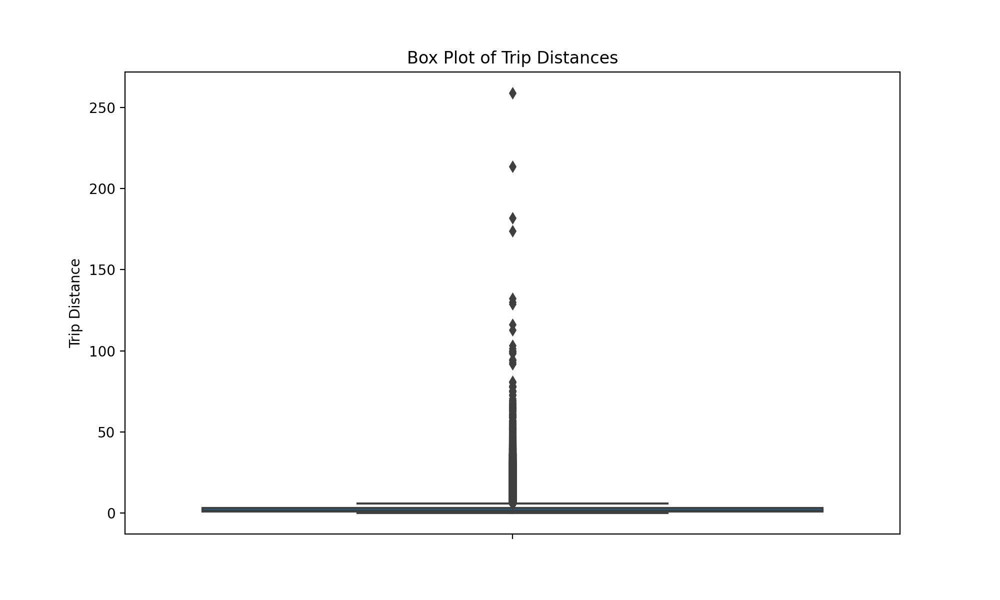

In [28]:
# let's see whether there are any outliers in trip distances now that we have eliminated the outliers based on trip durations and taxi speeds.
#box-plot showing outliers in trip-distance
plt.figure(figsize=(10, 6))
sns.boxplot(y="trip_distance", data=frame_with_trip_details_filtered)
plt.title("Box Plot of Trip Distances")
plt.ylabel("Trip Distance")
plt.show()

In [29]:
# trip distance values at each percntile 0,10,20,30,40,50,60,70,80,90,100 
percentiles = np.arange(0, 101, 10)

# sort trip distance values
trip_distances = frame_with_trip_details_filtered["trip_distance"].values
sorted_distances = np.sort(trip_distances)
percentile_values = np.percentile(sorted_distances, percentiles)


for perc, value in zip(percentiles, percentile_values):
    print(f"{perc}th percentile value is {value}")

print(f"100th percentile value is {sorted_distances[-1]}")

0th percentile value is 0.01
10th percentile value is 0.66
20th percentile value is 0.9
30th percentile value is 1.1
40th percentile value is 1.39
50th percentile value is 1.69
60th percentile value is 2.07
70th percentile value is 2.6
80th percentile value is 3.6
90th percentile value is 5.97
100th percentile value is 258.9
100th percentile value is 258.9


In [30]:
#trip distance values at each percntile 90,91,92,93,94,95,96,97,98,99,100
percentiles = np.arange(90, 101)

#sort trip distance values
trip_distances = frame_with_trip_details_filtered["trip_distance"].values
sorted_distances = np.sort(trip_distances)
percentile_values = np.percentile(sorted_distances, percentiles)

for perc, value in zip(percentiles, percentile_values):
    print(f"{perc}th percentile value is {value}")

print(f"100th percentile value is {percentile_values[-1]}")

90th percentile value is 5.97
91th percentile value is 6.45
92th percentile value is 7.07
93th percentile value is 7.85
94th percentile value is 8.72
95th percentile value is 9.6
96th percentile value is 10.6
97th percentile value is 12.1
98th percentile value is 16.03
99th percentile value is 18.17
100th percentile value is 258.9
100th percentile value is 258.9


In [31]:
#trip distance values at each percntile 99.0,99.1,99.2,99.3,99.4,99.5,99.6,99.7,99.8,99.9,100
percentiles = np.arange(99.0, 100.1, 0.1)

#sort trip distance values
trip_distances = frame_with_trip_details_filtered["trip_distance"].values
sorted_distances = np.sort(trip_distances)
percentile_values = np.percentile(sorted_distances, percentiles)

for percentile, value in zip(percentiles, percentile_values):
    print(f"{percentile:.1f}th percentile value is {value}")

print(f"100th percentile value is {percentile_values[-1]}")

99.0th percentile value is 18.17
99.1th percentile value is 18.37
99.2th percentile value is 18.6
99.3th percentile value is 18.83
99.4th percentile value is 19.13
99.5th percentile value is 19.5
99.6th percentile value is 19.96
99.7th percentile value is 20.5
99.8th percentile value is 21.22
99.9th percentile value is 22.57
100.0th percentile value is 258.89999966248865
100th percentile value is 258.89999966248865


In [32]:
# Calculate the 99.9th percentile value for trip distances
percentile_99_9 = np.percentile(frame_with_trip_details['trip_distance'].values, 99.9)

# exclude rows where trip_distance is not within the acceptable range
frame_with_trip_details_filtered = frame_with_trip_details[
    (frame_with_trip_details['trip_distance'] > 0) &
    (frame_with_trip_details['trip_distance'] <= percentile_99_9)
]

print(f"Number of rows after filtering: {len(frame_with_trip_details_filtered)}")


Number of rows after filtering: 12656898


<IPython.core.display.Javascript object>


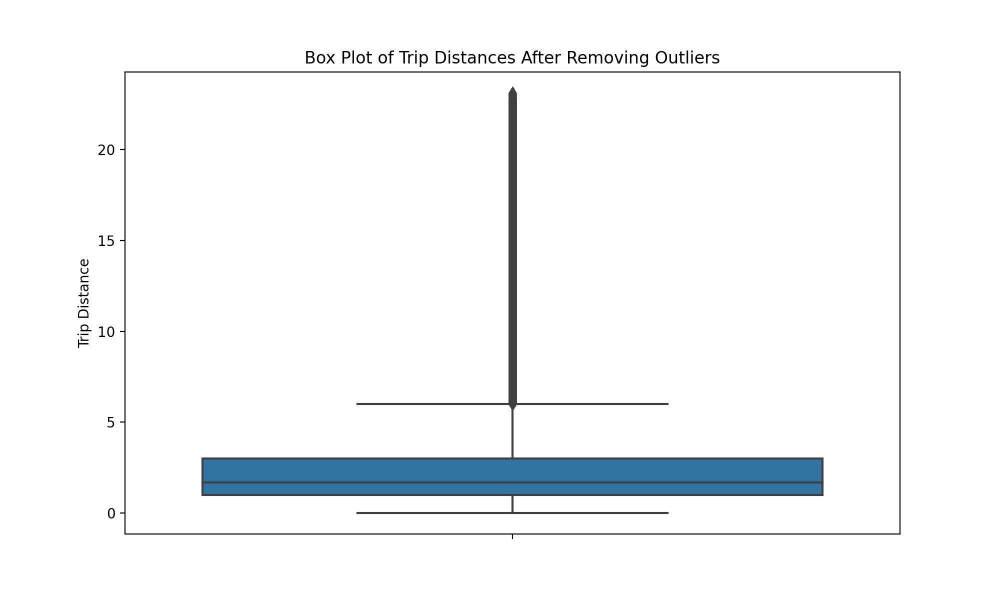

In [33]:
fig, ax = plt.subplots(figsize=(10, 6))
sns.boxplot(y='trip_distance', data=frame_with_trip_details_filtered, ax=ax)
ax.set_title('Box Plot of Trip Distances After Removing Outliers')
ax.set_ylabel('Trip Distance')
plt.show()

### Total Fare

<IPython.core.display.Javascript object>


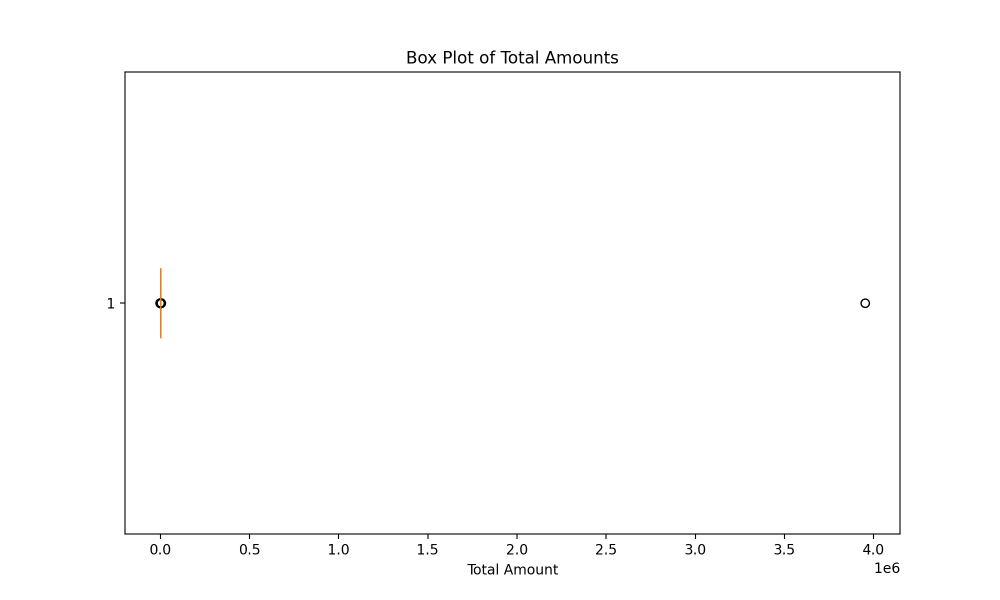

In [34]:
# Now that we have eliminated the outliers based on trip lengths, taxi speeds, and trip distances, let's look into any potential outliers in the datset based on 'total_amount' values.
# box-plot showing outliers in fares
plt.figure(figsize=(10, 6))
plt.boxplot(frame_with_trip_details_filtered['total_amount'], vert=False, patch_artist=True)
plt.xlabel('Total Amount')
plt.title('Box Plot of Total Amounts')
plt.show()

In [35]:
#total fare amount values at each percntile 0,10,20,30,40,50,60,70,80,90,100 
percentiles = np.arange(0, 101, 10)

# sort the 'total_amount' values
total_amounts = frame_with_trip_details_filtered["total_amount"].values
sorted_amounts = np.sort(total_amounts)
percentile_values = np.percentile(sorted_amounts, percentiles)

for p, value in zip(percentiles, percentile_values):
    print(f"{p}th percentile value is {value}")

print(f"100th percentile value is {sorted_amounts[-1]}")

0th percentile value is -242.55
10th percentile value is 6.3
20th percentile value is 7.8
30th percentile value is 8.8
40th percentile value is 9.8
50th percentile value is 11.16
60th percentile value is 12.8
70th percentile value is 14.8
80th percentile value is 18.3
90th percentile value is 25.8
100th percentile value is 3950611.6
100th percentile value is 3950611.6


In [36]:
#total fare amount values at each percntile 90,91,92,93,94,95,96,97,98,99,100
percentile_range = np.arange(90, 101) 
# sort the 'total_amount' values
total_amounts = frame_with_trip_details_filtered["total_amount"].values
sorted_amounts = np.sort(total_amounts)
percentile_values = np.percentile(sorted_amounts, percentile_range)

for p, value in zip(percentile_range, percentile_values):
    print(f"{p}th percentile value is {value}")

print(f"100th percentile value is {sorted_amounts[-1]}")

90th percentile value is 25.8
91th percentile value is 27.3
92th percentile value is 29.3
93th percentile value is 31.8
94th percentile value is 34.85
95th percentile value is 38.53
96th percentile value is 42.6
97th percentile value is 48.13
98th percentile value is 58.13
99th percentile value is 66.13
100th percentile value is 3950611.6
100th percentile value is 3950611.6


In [37]:
#total fare amount values at each percntile 99.0,99.1,99.2,99.3,99.4,99.5,99.6,99.7,99.8,99.9,100
percentile_steps = np.arange(99.0, 100.1, 0.1) 

# sort the 'total_amount' values
total_amounts = frame_with_trip_details_filtered["total_amount"].values
sorted_amounts = np.sort(total_amounts)
percentile_values = np.percentile(sorted_amounts, percentile_steps)

for step, value in zip(percentile_steps, percentile_values):
    print(f"{step:.1f} percentile value is {value}")

print(f"100th percentile value is {sorted_amounts[-1]}")

99.0 percentile value is 66.13
99.1 percentile value is 68.13
99.2 percentile value is 69.6
99.3 percentile value is 69.6
99.4 percentile value is 69.73
99.5 percentile value is 69.75
99.6 percentile value is 69.76
99.7 percentile value is 72.63
99.8 percentile value is 75.4920599999465
99.9 percentile value is 88.38
100.0 percentile value is 3950611.5705955215
100th percentile value is 3950611.6


##### Observation: Since there is little variation between the 99.8th and 99.9th percentiles and even the 99.9th percentile figure does not appear to be an anomaly, we proceed to perform a graphical analysis.

<IPython.core.display.Javascript object>


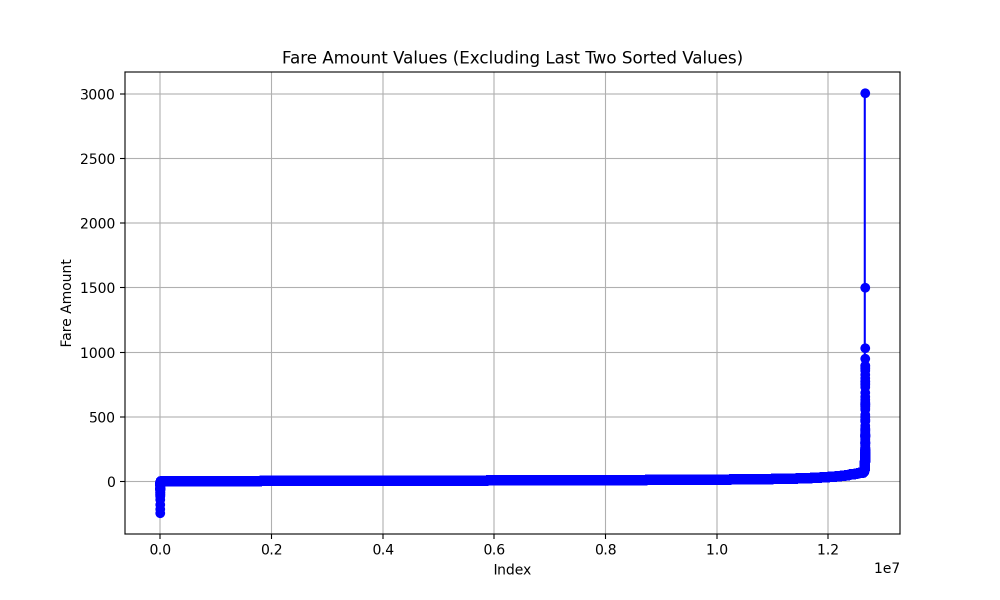

In [38]:
#The plot below sorts the fare values so that we can see any sharp increases and eliminate them as outliers.
#plot the fare amount in the sorted data, taking the final two numbers out.
# sort the 'total_amount' values
total_amounts = frame_with_trip_details_filtered["total_amount"].values
sorted_amounts = np.sort(total_amounts)

#range of data to plot (excluding the last two values)
data_to_plot = sorted_amounts[:-2]

plt.figure(figsize=(10, 6))
plt.plot(data_to_plot, marker='o', linestyle='-', color='b')
plt.title('Fare Amount Values (Excluding Last Two Sorted Values)')
plt.xlabel('Index')
plt.ylabel('Fare Amount')
plt.grid(True)
plt.show()

<IPython.core.display.Javascript object>


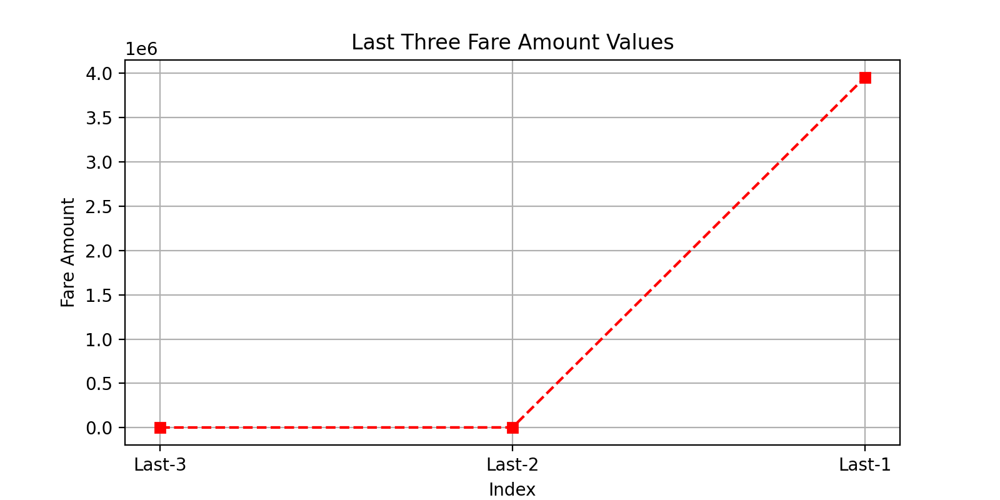

In [39]:
#Plotting the last three total fare values, we can see that there has been a share increase in the values. 
# a very significant increase in fare values can be noted.
# sort the 'total_amount' values
total_amounts = frame_with_trip_details_filtered["total_amount"].values
sorted_amounts = np.sort(total_amounts)

# the last three values
last_three_amounts = sorted_amounts[-3:]

plt.figure(figsize=(8, 4))
plt.plot(last_three_amounts, marker='s', color='r', linestyle='--')
plt.title('Last Three Fare Amount Values')
plt.xlabel('Index')
plt.ylabel('Fare Amount')
plt.xticks(ticks=range(3), labels=['Last-3', 'Last-2', 'Last-1'])
plt.grid(True)
plt.show()

<IPython.core.display.Javascript object>


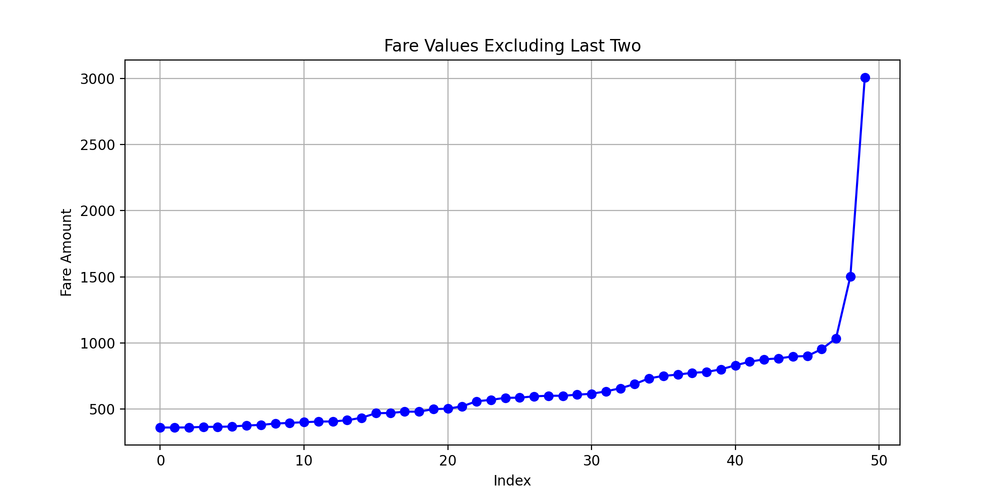

In [40]:
#we plot the latest 50 values ignoring the final two values. 
#looking at data without including the last two points, we again notice a huge spike at about 1000 fare value.
#sort the 'total_amount' values
fare_amounts = frame_with_trip_details_filtered["total_amount"].values
sorted_fares = np.sort(fare_amounts)

#range of the last 50 values, excluding the last two
values_to_plot = sorted_fares[-52:-2]

plt.figure(figsize=(10, 5))
plt.plot(values_to_plot, marker='o', linestyle='-', color='b')
plt.title('Fare Values Excluding Last Two')
plt.xlabel('Index')
plt.ylabel('Fare Amount')
plt.grid(True)
plt.show()

### Remove all outliers/erronous points from data

In [41]:
def filter_outliers(new_df):
    # Total number of records before any filtering
    total_records = new_df.shape[0]
    print(f"Initial number of records: {total_records}")

    # Filter records based on geographic coordinates
    filtered_by_location = new_df[
        (new_df.dropoff_longitude.between(-74.15, -73.7004)) &
        (new_df.dropoff_latitude.between(40.5774, 40.9176)) &
        (new_df.pickup_longitude.between(-74.15, -73.7004)) &
        (new_df.pickup_latitude.between(40.5774, 40.9176))
    ]
    records_after_location_filter = filtered_by_location.shape[0]
    print(f"Records outside NYC boundaries removed: {total_records - records_after_location_filter}")

    # filter records based on trip duration
    filtered_by_time = filtered_by_location[
        (filtered_by_location.trip_duration > 0) &
        (filtered_by_location.trip_duration < 720)
    ]
    records_after_time_filter = filtered_by_time.shape[0]
    print(f"Records removed based on trip times: {records_after_location_filter - records_after_time_filter}")

    # filter records based on trip distance
    filtered_by_distance = filtered_by_time[
        (filtered_by_time.trip_distance > 0) &
        (filtered_by_time.trip_distance < 22.67)
    ]
    records_after_distance_filter = filtered_by_distance.shape[0]
    print(f"Records removed based on trip distance: {records_after_time_filter - records_after_distance_filter}")

    # filter records based on speed
    filtered_by_speed = filtered_by_distance[
        (filtered_by_distance.speed_mph > 0) &
        (filtered_by_distance.speed_mph < 45.31)
    ]
    records_after_speed_filter = filtered_by_speed.shape[0]
    print(f"Records removed based on speed: {records_after_distance_filter - records_after_speed_filter}")

    # filter records based on fare amount
    filtered_by_fare = filtered_by_speed[
        (filtered_by_speed.total_amount > 0) &
        (filtered_by_speed.total_amount < 1000)
    ]
    records_after_fare_filter = filtered_by_fare.shape[0]
    print(f"Records removed based on fare amount: {records_after_speed_filter - records_after_fare_filter}")

    # Final number of records after all filtering
    final_records = filtered_by_fare.shape[0]
    print(f"Total records removed: {total_records - final_records}")
    print("---")

    return filtered_by_fare


In [42]:
print("Filtering outliers for Jan 2015 data")
print("----")

# function to filter outliers from the dataset
outlier_removed_data = filter_outliers(frame_with_trip_details)

# proportion of data points that are retained after filtering
remaining_fraction = len(outlier_removed_data) / len(frame_with_trip_details)

print(f"Proportion of data points remaining after outlier removal: {remaining_fraction:.4f}")

Filtering outliers for Jan 2015 data
----
Initial number of records: 12748986
Records outside NYC boundaries removed: 293919
Records removed based on trip times: 9213
Records removed based on trip distance: 56203
Records removed based on speed: 16723
Records removed based on fare amount: 2921
Total records removed: 378979
---
Proportion of data points remaining after outlier removal: 0.9703


# Data Preparation

## Clustering or Segmentation

In [43]:
#experimenting with various cluster sizes to determine the ideal K for K-means
# Coordinates for clustering
coord = outlier_removed_data[['pickup_latitude', 'pickup_longitude']].values
distance_info = []

def calculate_min_distance_between_clusters(centers, num_clusters):
    within_vicinity = []
    outside_vicinity = []
    min_distance = float('inf')
    
    for i in range(num_clusters):
        nearby_count = 0
        distant_count = 0
        
        for j in range(num_clusters):
            if j != i:
                dist_miles = gpxpy.geo.haversine_distance(
                    centers[i][0], centers[i][1], 
                    centers[j][0], centers[j][1]
                ) / 1609.34  # Convert meters to miles
                
                min_distance = min(min_distance, dist_miles)
                
                if dist_miles <= 2:
                    nearby_count += 1
                else:
                    distant_count += 1
                    
        within_vicinity.append(nearby_count)
        outside_vicinity.append(distant_count)
    
    distance_info.append(within_vicinity)
    
    avg_nearby = np.ceil(np.mean(within_vicinity))
    avg_distant = np.ceil(np.mean(outside_vicinity))
    
    print(f"Evaluating cluster count of {num_clusters}:")
    print(f"Average clusters within 2 miles: {avg_nearby}")
    print(f"Average clusters beyond 2 miles: {avg_distant}")
    print(f"Minimum inter-cluster distance: {min_distance:.2f} miles")
    print("---")

def perform_clustering(num_clusters):
    kmeans = MiniBatchKMeans(n_clusters=num_clusters, batch_size=10000, random_state=42)
    kmeans.fit(coord)
    outlier_removed_data['cluster_label'] = kmeans.predict(coord)
    return kmeans.cluster_centers_, len(kmeans.cluster_centers_)

#In order to ensure that there are more cluster regions around any cluster center, 
# we must select the number of clusters and ensure that the minimum inter-cluster distance is not extremely low.
# Iterate over different cluster sizes to determine the best K value
for cluster_count in range(10, 100, 10):
    centers, cluster_count = perform_clustering(cluster_count)
    calculate_min_distance_between_clusters(centers, cluster_count)


Evaluating cluster count of 10:
Average clusters within 2 miles: 3.0
Average clusters beyond 2 miles: 7.0
Minimum inter-cluster distance: 1.00 miles
---
Evaluating cluster count of 20:
Average clusters within 2 miles: 5.0
Average clusters beyond 2 miles: 15.0
Minimum inter-cluster distance: 0.66 miles
---
Evaluating cluster count of 30:
Average clusters within 2 miles: 8.0
Average clusters beyond 2 miles: 22.0
Minimum inter-cluster distance: 0.44 miles
---
Evaluating cluster count of 40:
Average clusters within 2 miles: 12.0
Average clusters beyond 2 miles: 28.0
Minimum inter-cluster distance: 0.35 miles
---
Evaluating cluster count of 50:
Average clusters within 2 miles: 14.0
Average clusters beyond 2 miles: 36.0
Minimum inter-cluster distance: 0.34 miles
---
Evaluating cluster count of 60:
Average clusters within 2 miles: 15.0
Average clusters beyond 2 miles: 45.0
Minimum inter-cluster distance: 0.29 miles
---
Evaluating cluster count of 70:
Average clusters within 2 miles: 19.0
Aver

##### Conclusion: The primary goal was to determine the ideal minimum distance between the clusters, which we found to be 40. This distance roughly corresponds to a cluster's radius.

In [44]:
#We select 40 clusters to address the remaining issue since, when checking the 50 clusters, 
#we find that two of them are only 0.3 miles away.

# Perform clustering with 40 clusters
kmeans = MiniBatchKMeans(n_clusters=40, batch_size=10000, random_state=0)
kmeans.fit(coord)

outlier_removed_data['cluster_pickup'] = kmeans.predict(outlier_removed_data[['pickup_latitude', 'pickup_longitude']])

### plotting the cluster centres

In [45]:
# Coordinates for clustering
centers = kmeans.cluster_centers_
num_centers = len(centers)

# map centered around a specific latitude and longitude
osm_map = folium.Map(location=[40.734695, -73.990372], zoom_start=12, tiles='OpenStreetMap')

# Add markers for each cluster center
for center in centers:
    latitude, longitude = center
    folium.Marker(
        location=[latitude, longitude],
        popup=f'Lat: {latitude:.4f}, Lon: {longitude:.4f}'
    ).add_to(osm_map)

map_html_path = 'cluster_centers_map.html'
osm_map.save(map_html_path)

display(IFrame(src=map_html_path, width=800, height=600))

### plotting the clusters

<IPython.core.display.Javascript object>


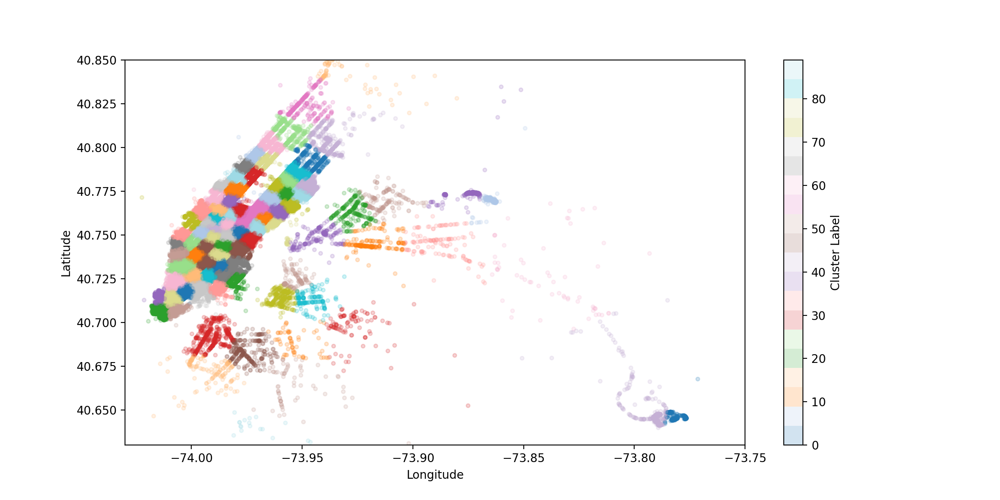

In [46]:
def visualize_clusters(data):
    # boundaries for the city map view
    lon_bounds = (-74.03, -73.75)
    lat_bounds = (40.63, 40.85)
    
    fig, ax = plt.subplots(figsize=(12, 6))
    
    # pickup locations with cluster color coding
    scatter = ax.scatter(
        data.pickup_longitude.head(100000),  
        data.pickup_latitude.head(100000),   
        c=data.cluster_label.head(100000),  
        cmap='tab20',                        
        s=10,                              
        alpha=0.2                          
    )
    
    # axis limits to focus on the city area
    ax.set_xlim(lon_bounds)
    ax.set_ylim(lat_bounds)
    ax.set_xlabel('Longitude')
    ax.set_ylabel('Latitude')
    plt.colorbar(scatter, ax=ax, label='Cluster Label')
    plt.show()

visualize_clusters(outlier_removed_data)

## Time-Binning

In [47]:
#Reference Link: https://www.unixtimestamp.com/
# 1420070400 : 2015-01-01 00:00:00 
# 1422748800 : 2015-02-01 00:00:00 
# 1425168000 : 2015-03-01 00:00:00
# 1427846400 : 2015-04-01 00:00:00 
# 1430438400 : 2015-05-01 00:00:00 
# 1433116800 : 2015-06-01 00:00:00

# 1451606400 : 2016-01-01 00:00:00 
# 1454284800 : 2016-02-01 00:00:00 
# 1456790400 : 2016-03-01 00:00:00
# 1459468800 : 2016-04-01 00:00:00 
# 1462060800 : 2016-05-01 00:00:00 
# 1464739200 : 2016-06-01 00:00:00

In [48]:
coord = outlier_removed_data[['pickup_latitude', 'pickup_longitude']].values

# Train the KMeans model with 40 clusters (or the number you desire)
kmeans = MiniBatchKMeans(n_clusters=40, batch_size=10000, random_state=0)
kmeans.fit(coord)

# Assign cluster labels based on the trained model
outlier_removed_data['cluster_pickup'] = kmeans.predict(coord)

In [49]:
def assign_pickup_bins(data, month, year):
    unix_times = [
        [1420070400,1422748800,1425168000,1427846400,1430438400,1433116800],  # 2015
        [1451606400,1454284800,1456790400,1459468800,1462060800,1464739200]   # 2016
    ]
    start_time = unix_times[year - 2015][month - 1]
    data['pickup_bins'] = ((data['pickup_unix'] - start_time) / 600).astype(int) + 33
    return data

# binning to the dataset for January 2015
january_2015_data = assign_pickup_bins(outlier_removed_data, month=1, year=2015)

# Group data by cluster and pickup bins, then count the number of trips in each group
grouped_january_2015 = january_2015_data.groupby(['cluster_pickup', 'pickup_bins'])['trip_distance'].size().reset_index(name='trip_distance')

In [50]:
print(outlier_removed_data.columns)

Index(['passenger_count', 'trip_distance', 'pickup_longitude',
       'pickup_latitude', 'dropoff_longitude', 'dropoff_latitude',
       'total_amount', 'trip_duration', 'pickup_unix', 'speed_mph',
       'cluster_label', 'cluster_pickup', 'pickup_bins'],
      dtype='object')


In [51]:
# provided two additional columns: "pickup_bins," which indicates which 10-min interval the trip belongs to, 
#and "cluster_pickup," which indicates to which cluster it belongs.
january_2015_data.head()

,passenger_count,trip_distance,pickup_longitude,pickup_latitude,dropoff_longitude,dropoff_latitude,total_amount,trip_duration,pickup_unix,speed_mph,cluster_label,cluster_pickup,pickup_bins
0,1,1.59,-73.993896,40.750111,-73.974785,40.750618,17.05,18.050000,1.421349e+09,5.285319,7,8,2163
1,1,3.30,-74.001648,40.724243,-73.994415,40.759109,17.80,19.833333,1.420922e+09,9.983193,17,35,1452
2,1,1.80,-73.963341,40.802788,-73.951820,40.824413,10.80,10.050000,1.420922e+09,10.746269,58,6,1452
3,1,0.50,-74.009087,40.713818,-74.004326,40.719986,4.80,1.866667,1.420922e+09,16.071429,76,25,1452
4,1,3.00,-73.971176,40.762428,-74.004181,40.742653,16.30,19.316667,1.420922e+09,9.318378,55,10,1452


In [52]:
#In this case, the trip_distance indicates how many pickups took place within that specific 10-min window. 
#This data frame has two indices.
#The cluster number is the primary index, while the pickup_bins secondary index is calculated 
#by dividing the entire month's duration into 10-minute increments (24*31*60/10 = 4464bins).
grouped_january_2015.head()

,cluster_pickup,pickup_bins,trip_distance
0,0,33,134
1,0,34,165
2,0,35,116
3,0,36,79
4,0,37,76


In [53]:
# so far cleaned and prepared the data for the month of 2015.

# repeated these steps for the months of January, February, and March in 2016: 
# 1. get the dataframe with only the columns that are necessary.
# 2. Adding trip durations, velocities, and the unix time stamp of the pickup time
# 3. take outliers depending on trip_times, trip_duration, speed, and total_amount; 
# 4. give each data point a pickup_cluster
# 5. add pickup_bin (the trip's index of the 10 minutes of travel) 
# 6. group by data using 'cluster_pickup' and 'pickup_bins'

# Data Preparation for the months of Jan,Feb and March 2016
def datapreparation(df,kmeans,month_no,year_no):
    
    print ("Return with trip times..")

    frame_with_trip_details = calculate_trip_details(df)
    
    print ("Remove outliers..")
    outlier_removed_data = filter_outliers(frame_with_trip_details)
    
    print ("Estimating clusters..")
    outlier_removed_data['cluster_pickup'] = kmeans.predict(outlier_removed_data[['pickup_latitude', 'pickup_longitude']])

    print ("Final groupbying..")
    final_updated_frame = assign_pickup_bins(outlier_removed_data,month_no,year_no)
    final_groupby_frame = final_updated_frame[['cluster_pickup','pickup_bins','trip_distance']].groupby(['cluster_pickup','pickup_bins']).count()
    
    return final_updated_frame,final_groupby_frame
    
month_jan_2016 = dd.read_csv('/Users/rolex/Desktop/Dissertation/Data/yellow_tripdata_2016-01.csv.zip')
month_feb_2016 = dd.read_csv('/Users/rolex/Desktop/Dissertation/Data/yellow_tripdata_2016-02.csv.zip')
month_mar_2016 = dd.read_csv('/Users/rolex/Desktop/Dissertation/Data/yellow_tripdata_2016-03.csv.zip')

jan_2016_frame,jan_2016_groupby = datapreparation(month_jan_2016,kmeans,1,2016)
feb_2016_frame,feb_2016_groupby = datapreparation(month_feb_2016,kmeans,2,2016)
mar_2016_frame,mar_2016_groupby = datapreparation(month_mar_2016,kmeans,3,2016)

Return with trip times..
Remove outliers..
Initial number of records: 10906858
Records outside NYC boundaries removed: 214677
Records removed based on trip times: 15815
Records removed based on trip distance: 50210
Records removed based on speed: 15124
Records removed based on fare amount: 3174
Total records removed: 299000
---
Estimating clusters..
Final groupbying..
Return with trip times..
Remove outliers..
Initial number of records: 11382049
Records outside NYC boundaries removed: 223161
Records removed based on trip times: 15365
Records removed based on trip distance: 52067
Records removed based on speed: 15445
Records removed based on fare amount: 3291
Total records removed: 309329
---
Estimating clusters..
Final groupbying..
Return with trip times..
Remove outliers..
Initial number of records: 12210952
Records outside NYC boundaries removed: 232444
Records removed based on trip times: 21635
Records removed based on trip distance: 55544
Records removed based on speed: 16114
Recor

## Smoothing

In [54]:
# Retrieve the unique pickup bins where pickups are present for each cluster region

# For each cluster, gather all unique 10-minute intervals where pickups occurred.
# Note: Some bins might not have any pickups.

def get_unique_pickup_bins(data):
    unique_bins = []
    
    for cluster_id in range(40):
        cluster_data = data[data['cluster_pickup'] == cluster_id]
        unique_intervals = sorted(cluster_data['pickup_bins'].unique())
        unique_bins.append(unique_intervals)
        
    return unique_bins

In [55]:
# For each month, obtain the indices of 10-minute intervals with at least one pickup

# January
unique_jan_2015 = get_unique_pickup_bins(january_2015_data)
unique_jan_2016 = get_unique_pickup_bins(jan_2016_frame)

# February
unique_feb_2016 = get_unique_pickup_bins(feb_2016_frame)

# March
unique_mar_2016 = get_unique_pickup_bins(mar_2016_frame)

In [56]:
# number of 10-minute intervals with zero pickups for each cluster
total_intervals = 4464

for cluster_id in range(40):
    zero_pickups = total_intervals - len(set(unique_jan_2015[cluster_id]))
    print(f"Cluster {cluster_id}: Number of 10-minute intervals with zero pickups: {zero_pickups}")
    print('-' * 60)

Cluster 0: Number of 10-minute intervals with zero pickups: 34
------------------------------------------------------------
Cluster 1: Number of 10-minute intervals with zero pickups: 415
------------------------------------------------------------
Cluster 2: Number of 10-minute intervals with zero pickups: 41
------------------------------------------------------------
Cluster 3: Number of 10-minute intervals with zero pickups: 371
------------------------------------------------------------
Cluster 4: Number of 10-minute intervals with zero pickups: 30
------------------------------------------------------------
Cluster 5: Number of 10-minute intervals with zero pickups: 37
------------------------------------------------------------
Cluster 6: Number of 10-minute intervals with zero pickups: 39
------------------------------------------------------------
Cluster 7: Number of 10-minute intervals with zero pickups: 52
------------------------------------------------------------
Cluste

##### There are two methods for entering these values:

Add zeros to the missing value.

Use the average values to fill in the blanks.

    Case 1: (initial values absent)
    Example1: x = ceil(x/4) + ceil(x/4) + ceil(x/4)
     Ex2: x = ceil(x/3) + ceil(x/3)
      --------------------------------------

    Case 2: (middle values missing)
    In Example 1, x and y are equivalent to ceil((x+y)/4) and ceil((x+y)/4), respectively.
    The second example is x,y => ceil((x+y)/5), ceil((x+y)/5), ceil((x+y)/5), ceil((x+y)/5), ceil((x+y)/5)
    The information provided is incomplete and may need to be improved.
    
    Case 3: (final values absent)
    Example1: x = ceil(x/4) + ceil(x/4) + ceil(x/4)
    x => ceil(x/2), ceil(x/2) in Ex2

In [57]:
# The count_values: number of pickups that occur in each region for every 10-min interval 
# There won't be any value if there are no pickups. 
# Fills a value of zero for each bin where no pickup data is present.
#values: quantity of distinct bins

# will check to see if it is in the unique bin every 10 minutes (pickup bin). 
#If it is,  will add count values[index] to the smoothed data; if not,  add 0 to the smoothed data. 
# Finally,  return the smoothed data.
def fill_missing_bins(count_values, unique_bins):
    smoothed_data = []
    counter = 0

    for region in range(40):
        smoothed_region_data = []
        for interval in range(4464):
            if interval in unique_bins[region]:
                smoothed_region_data.append(count_values[counter])
                counter += 1
            else:
                smoothed_region_data.append(0)
        smoothed_data.extend(smoothed_region_data)

    return smoothed_data

In [58]:
# Inserts a zero value into each bin in which there is no pickup data. 
# the count_values: the total number of picksups that have happened in each region for every ten minutes. 
#If there are none, there is no value.
#values: quantity of distinct bins

# will check to see if it is in our unique bin every 10 minutes (pickup bin). 
#If it is, will add the count values [index] to the smoothed data. 
#If not, add smoothed data (which is calculated using the techniques covered in the above markdown cell). 
#Finally, we return smoothed data.
def smooth_missing_values(counts, unique_bins):
    smoothed_data = []  # Stores the final smoothed values for all regions
    current_index = 0
    skip_count = 0
    calculated_value = 0

    for region in range(40):
        region_smoothed = []  # Temporary list to store smoothed values for the current region
        skip_count = 0
        
        for interval in range(4464):
            if skip_count > 0:  # Skip over intervals that have already been smoothed
                skip_count -= 1
                continue

            if interval in unique_bins[region]: 
                region_smoothed.append(counts[current_index])
            else:
                if interval != 0:
                    # Calculate the right-hand limit by finding the next non-missing value
                    next_bin_index = next((j for j in range(interval, 4464) if j in unique_bins[region]), 0)
                    
                    if next_bin_index == 0:
                        # Case 1: Missing values at the end with no right-hand limit
                        calculated_value = counts[current_index - 1] / ((4463 - interval) + 2)
                        for j in range(interval, 4464):
                            region_smoothed.append(math.ceil(calculated_value))
                        region_smoothed[interval - 1] = math.ceil(calculated_value)
                        skip_count = 4463 - interval
                        current_index -= 1
                    else:
                        # Case 2: Missing values between two known values
                        calculated_value = (counts[current_index - 1] + counts[current_index]) / ((next_bin_index - interval) + 2)
                        for j in range(interval, next_bin_index + 1):
                            region_smoothed.append(math.ceil(calculated_value))
                        region_smoothed[interval - 1] = math.ceil(calculated_value)
                        skip_count = next_bin_index - interval
                else:
                    # Case 3: Missing values at the beginning with no left-hand limit
                    next_bin_index = next((j for j in range(interval, 4464) if j in unique_bins[region]), 0)
                    calculated_value = counts[current_index] / ((next_bin_index - interval) + 1)
                    for j in range(interval, next_bin_index + 1):
                        region_smoothed.append(math.ceil(calculated_value))
                    skip_count = next_bin_index - interval

            current_index += 1

        smoothed_data.extend(region_smoothed)

    return smoothed_data

In [59]:
# Fill missing intervals in Jan 2015 data with zeros
jan_2015_filled = fill_missing_bins(grouped_january_2015['trip_distance'].to_numpy(), unique_jan_2015)

# Apply smoothing to the filled Jan 2015 data
jan_2015_smoothed = smooth_missing_values(grouped_january_2015['trip_distance'].to_numpy(), unique_jan_2015)

In [60]:
# Calculate the number of 10-minute intervals for January 2015 and January 2016, February 2016, and March 2016
intervals_jan_2015 = 24 * 31 * 6  # 6 intervals per hour, 31 days in January
intervals_jan_2016 = intervals_jan_2015  # January 2016 has the same number of days
intervals_feb_2016 = 24 * 29 * 6  # 6 intervals per hour, 29 days in February (leap year)
intervals_mar_2016 = 24 * 30 * 6  # 6 intervals per hour, 30 days in March

# For January 2015, with 40 clusters, calculate the total number of 10-minute intervals
total_intervals_jan_2015 = 40 * intervals_jan_2015

print("Total number of 10-minute intervals across all clusters:", len(jan_2015_filled))

Total number of 10-minute intervals across all clusters: 178560


<IPython.core.display.Javascript object>


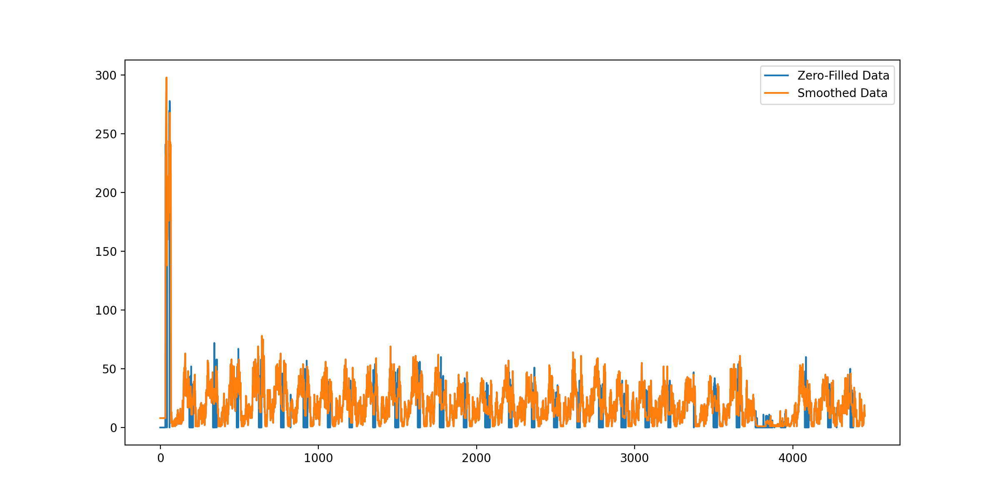

In [61]:
# Visualization: Comparison of Zero-Filled vs Smoothed Data
# A sample graphic illustrating two approaches to filling missing values 
# Plotting a segment of pickup counts for cluster region 2
plt.figure(figsize=(12, 6))

# Plotting zero-filled values for the selected cluster
plt.plot(jan_2015_filled[4464:8920], label="Zero-Filled Data")

# Plotting smoothed values for the selected cluster
plt.plot(jan_2015_smoothed[4464:8920], label="Smoothed Data")
plt.legend()
plt.show()

In [62]:
# Why did I select these techniques, and which technique is applied to what data?

# Let's assume that we have data for a specific month in 2015, such as January 1st, 10 _ _ _ 20, or 10 pickups in the first 
# 10 10-min interval, 0 pickups in the second # 10 min interval, 0 pickups in the third # 10 min interval, and 20 pickups in the fourth 
# 10 min period.
# We change these numbers as 10, 0, 0, 20 in the fill_missing method and as 6, 6, 6, 6, 6 in the smoothing method. 
# If we check, the number of pickups that occur in the first 40 minutes is the same in both situations, 
# but you can see that we are looking at the future values. 
 
# We are examining the amount of pickups in the future when you utilize smoothing, which could result in a data breach.

# As a result, we employ smoothing on the January 2015 data, which serves as our training set, 
# and the straightforward fill_missing approach on the 2016 data.

In [63]:
# smoothing to Jan 2015 data and zero-fill for Jan, Feb, and Mar 2016 data
jan_2015_smoothed = smooth_missing_values(grouped_january_2015['trip_distance'].values, unique_jan_2015)
jan_2016_filled = fill_missing_bins(jan_2016_groupby['trip_distance'].values, unique_jan_2016)
feb_2016_filled = fill_missing_bins(feb_2016_groupby['trip_distance'].values, unique_feb_2016)
mar_2016_filled = fill_missing_bins(mar_2016_groupby['trip_distance'].values, unique_mar_2016)

# pickup data across all bins for Jan, Feb, and Mar 2016, organized by region
cumulative_regions = []

#24*31*60/10 = 4464 is the number of 10-minute indexes for January 2015.
#24*31*60/10 = 4464 is the number of 10-minute indices for January 2016.
#The 10 minute index numbers for February 2016 are 24*29*60/10 = 4176, while March 2016 are 24*31*60/10 = 4464.
#cumulative_regions : it will have 40 lists, each of which will have 4464 + 4176 + 4464 numbers, 
#which indicate how many pickups 
#occurred in each of the 40 NYC clusters/regions during the course of three months in 2016.
for region_index in range(40):
    jan_values = jan_2016_filled[4464 * region_index: 4464 * (region_index + 1)]
    feb_values = feb_2016_filled[4176 * region_index: 4176 * (region_index + 1)]
    mar_values = mar_2016_filled[4464 * region_index: 4464 * (region_index + 1)]
    
    # Combine the values for all three months
    combined_values = jan_values + feb_values + mar_values
    
    cumulative_regions.append(combined_values)

print(len(cumulative_regions))
print(len(cumulative_regions[0]))

40
13104


# Time Series & Fourier Transforms

<IPython.core.display.Javascript object>


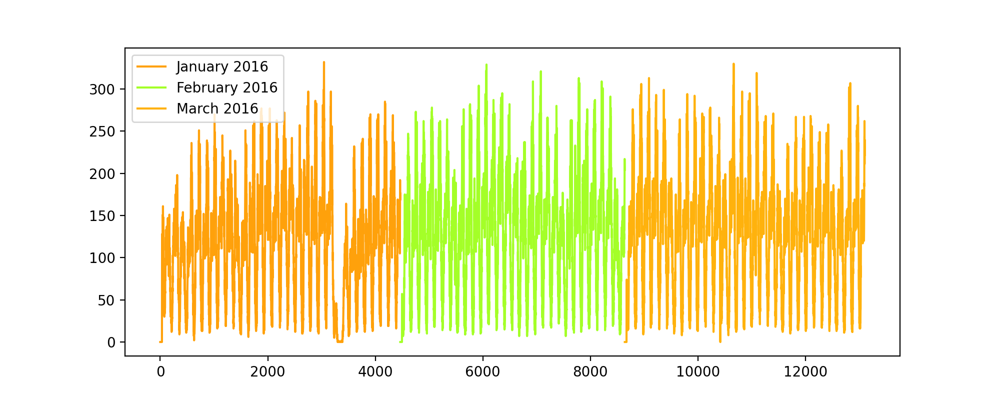

<IPython.core.display.Javascript object>


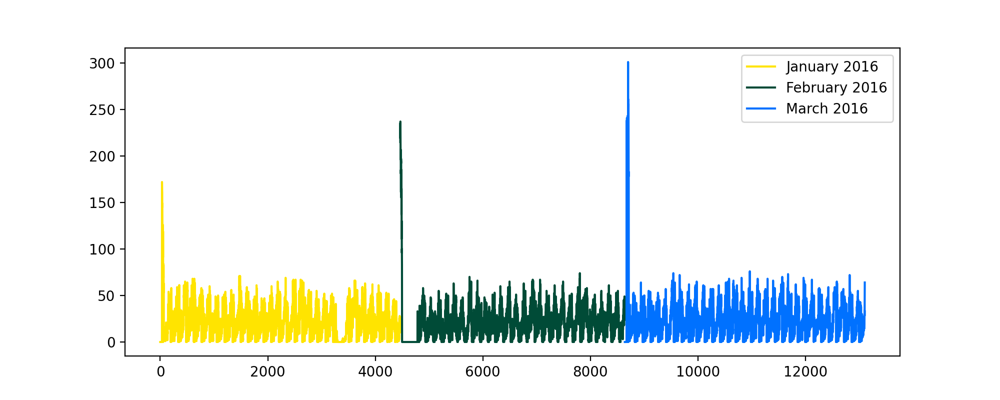

<IPython.core.display.Javascript object>


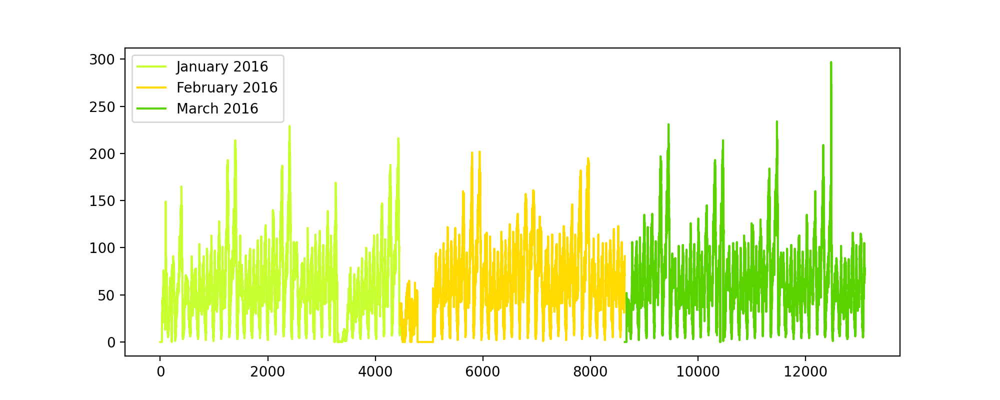

<IPython.core.display.Javascript object>


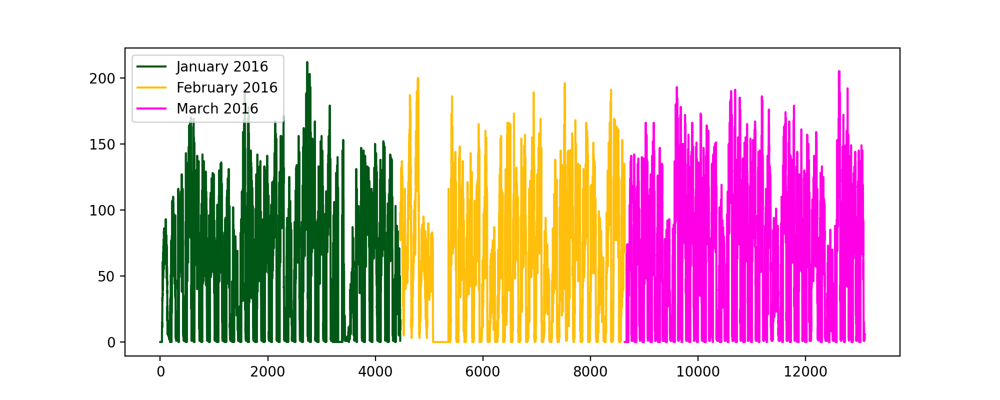

<IPython.core.display.Javascript object>


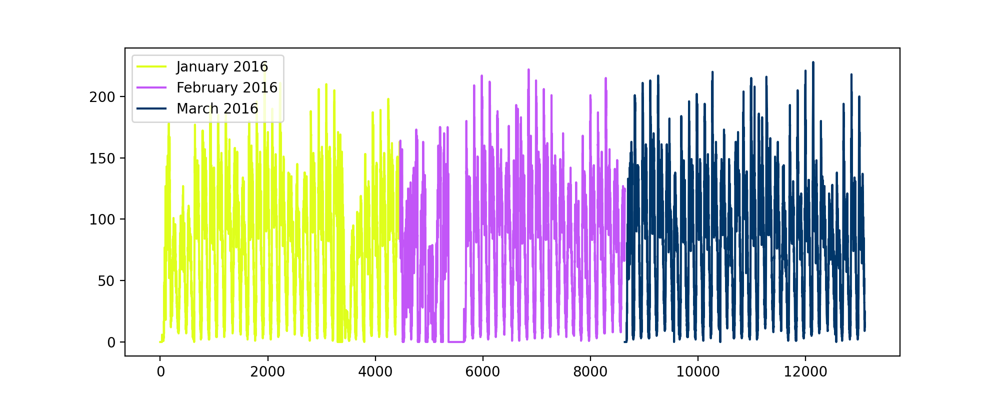

<IPython.core.display.Javascript object>


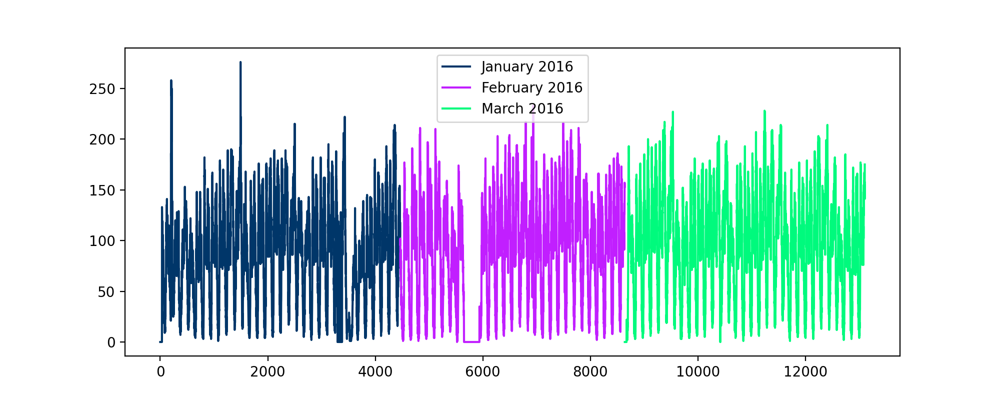

<IPython.core.display.Javascript object>


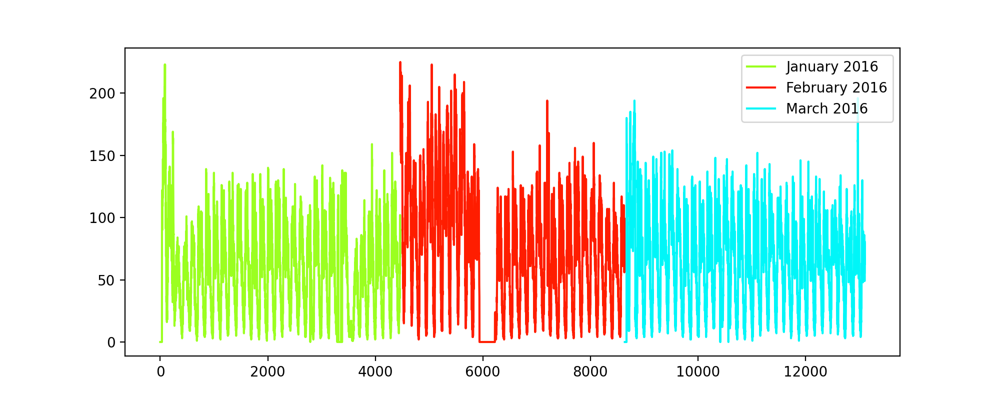

<IPython.core.display.Javascript object>


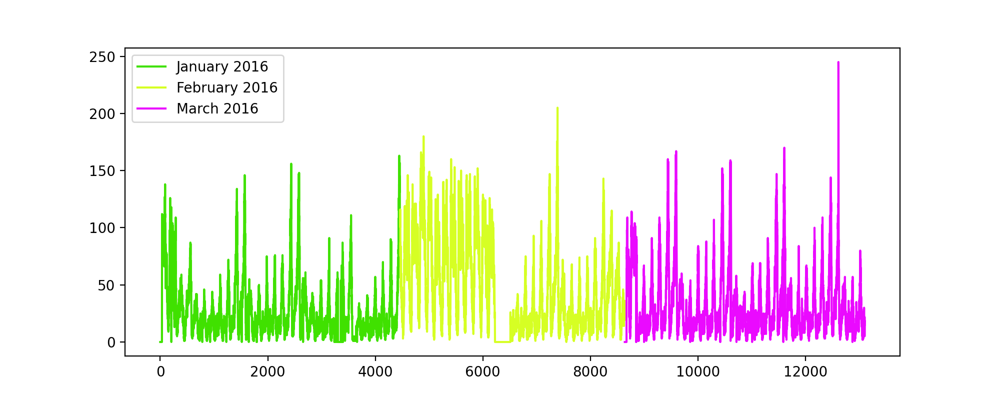

<IPython.core.display.Javascript object>


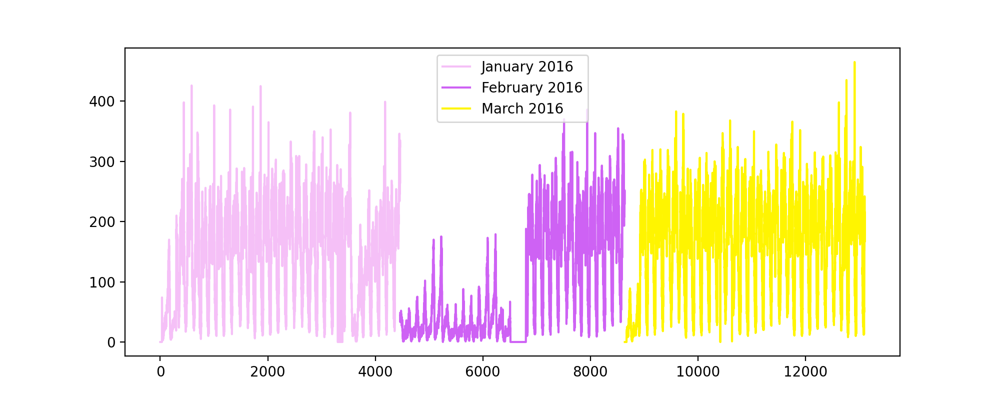

<IPython.core.display.Javascript object>


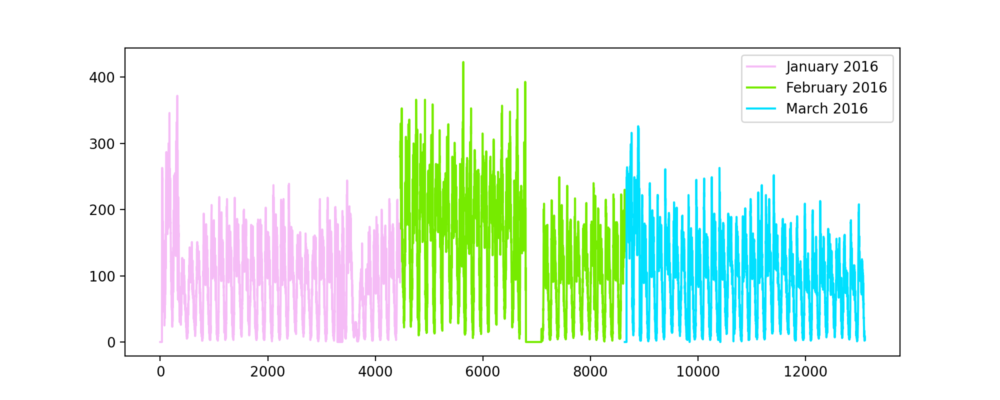

<IPython.core.display.Javascript object>


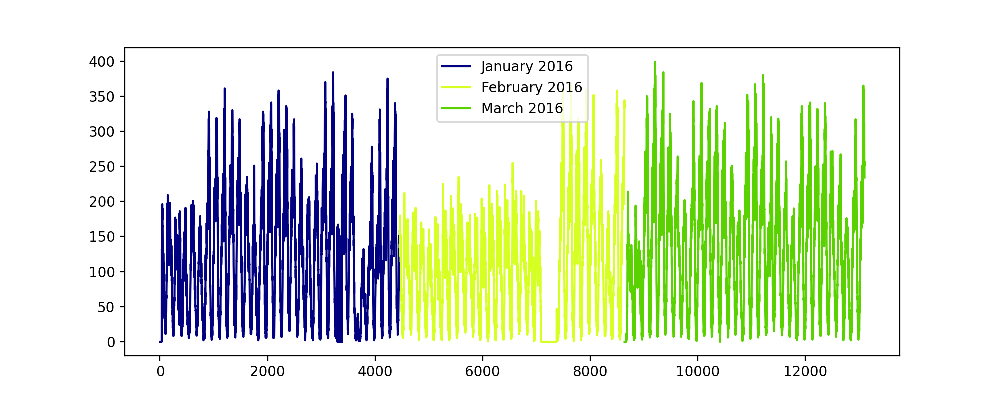

<IPython.core.display.Javascript object>


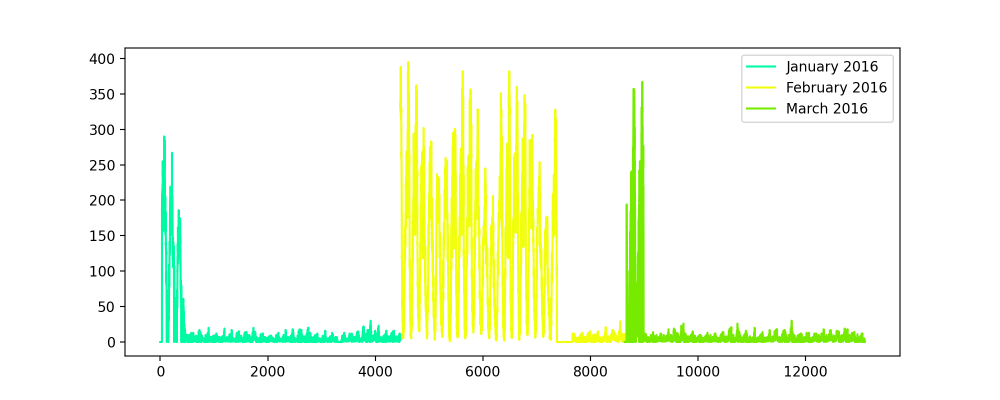

<IPython.core.display.Javascript object>


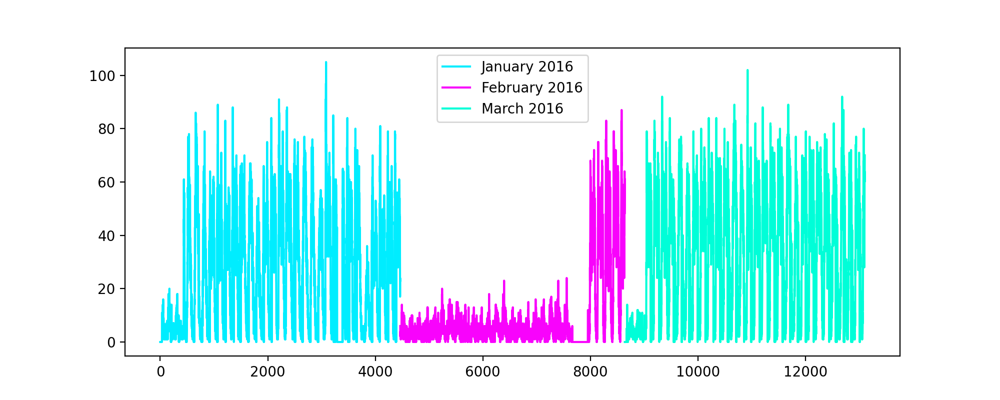

<IPython.core.display.Javascript object>


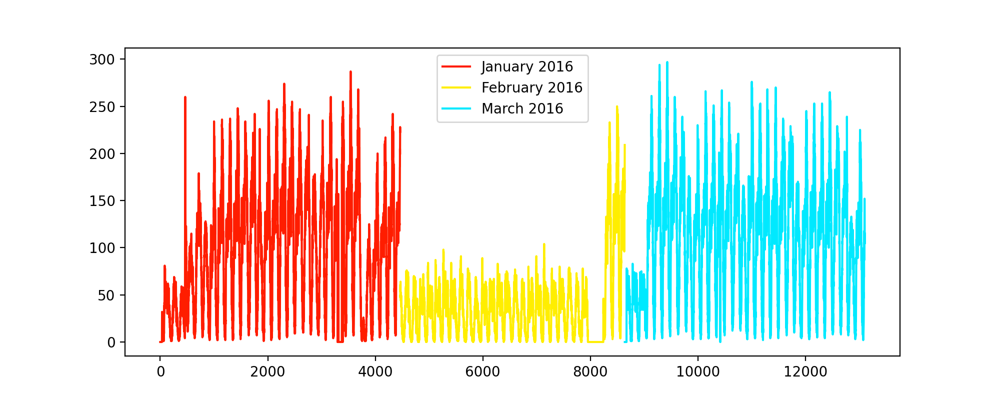

<IPython.core.display.Javascript object>


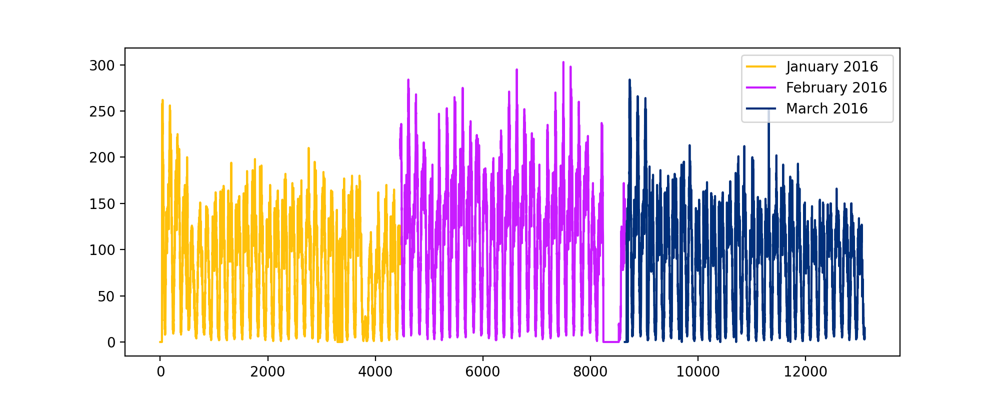

<IPython.core.display.Javascript object>


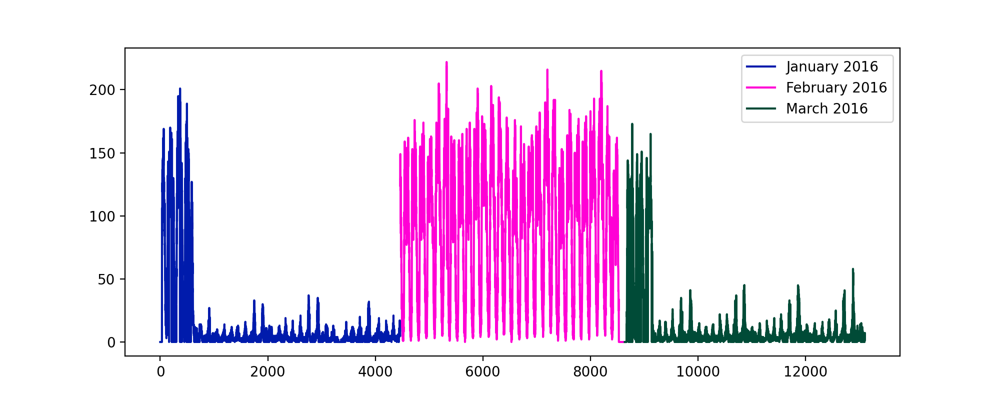

<IPython.core.display.Javascript object>


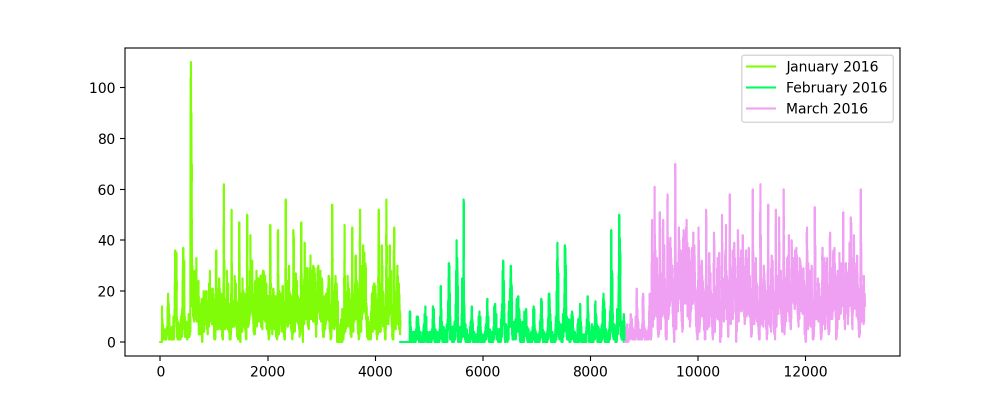

<IPython.core.display.Javascript object>


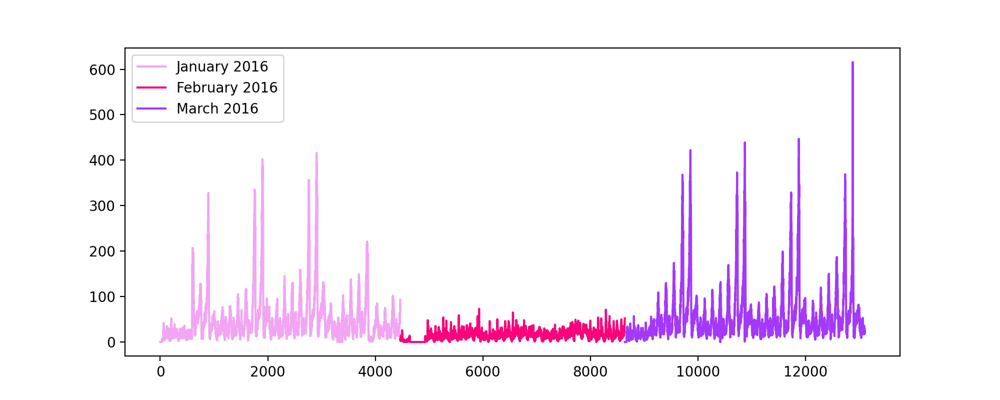

<IPython.core.display.Javascript object>


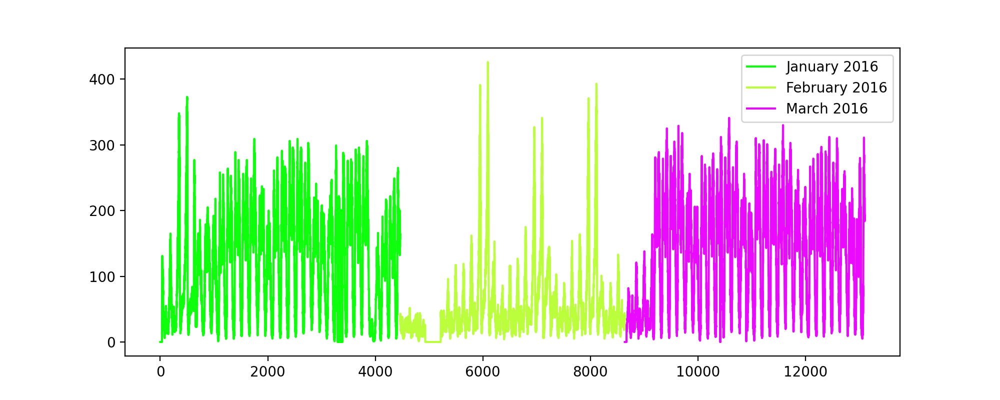

<IPython.core.display.Javascript object>


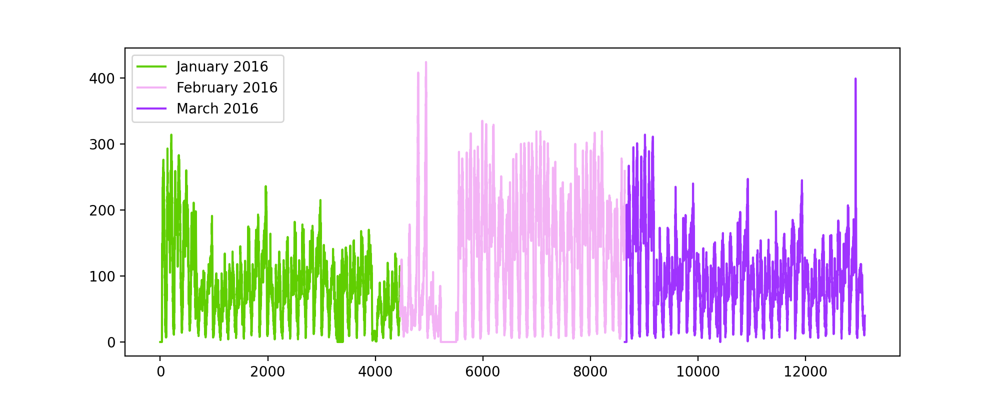

<IPython.core.display.Javascript object>


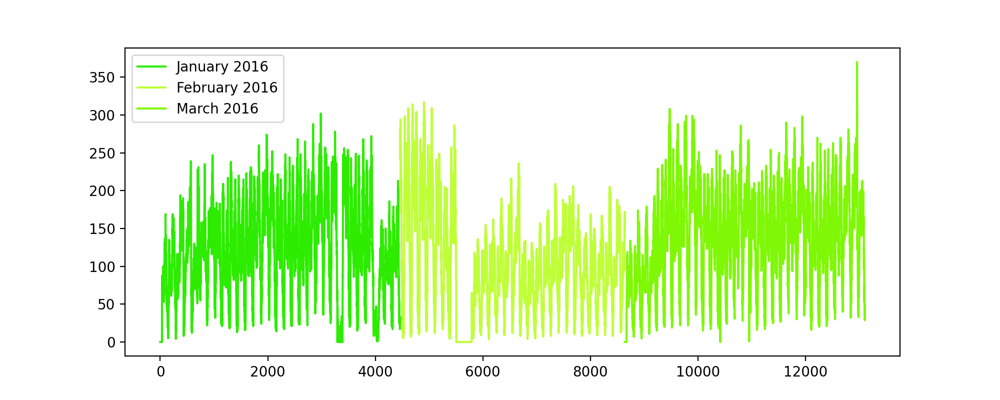

<IPython.core.display.Javascript object>


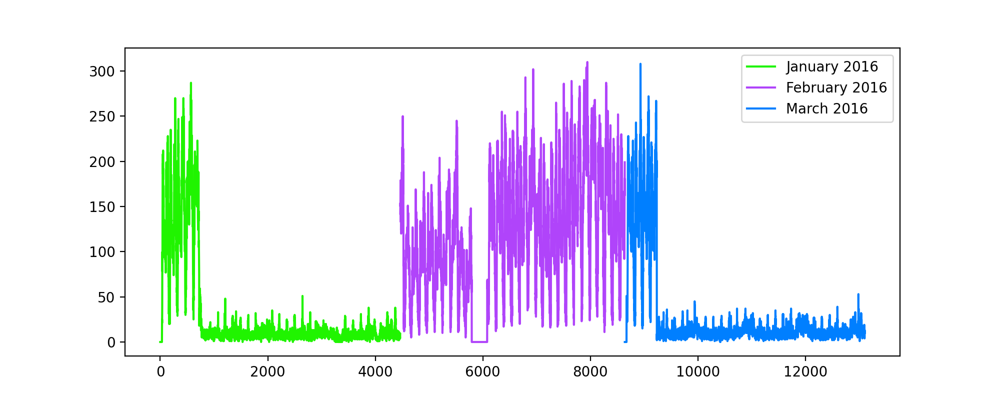

<IPython.core.display.Javascript object>


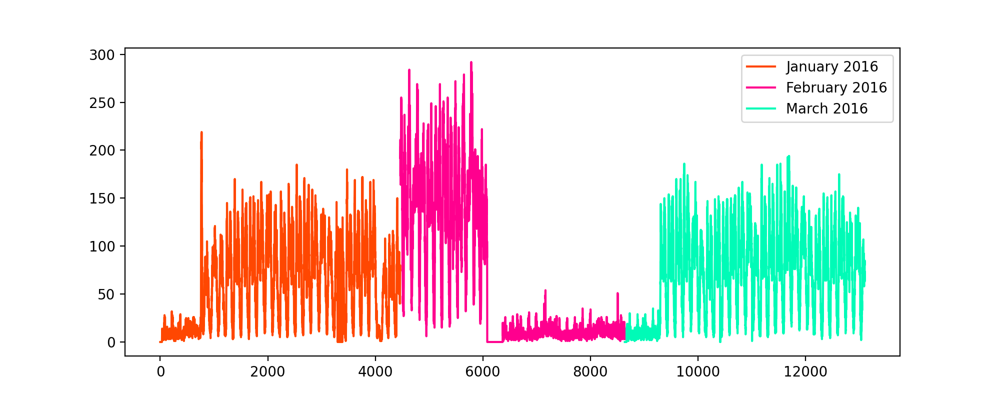

<IPython.core.display.Javascript object>


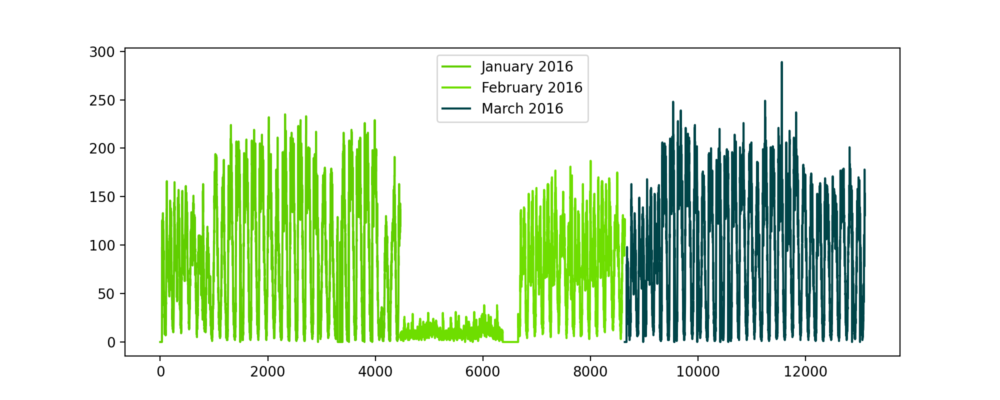

<IPython.core.display.Javascript object>


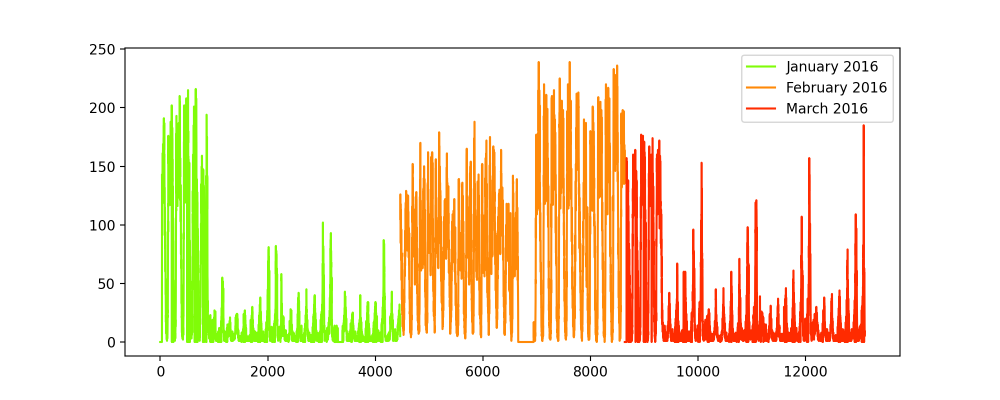

<IPython.core.display.Javascript object>


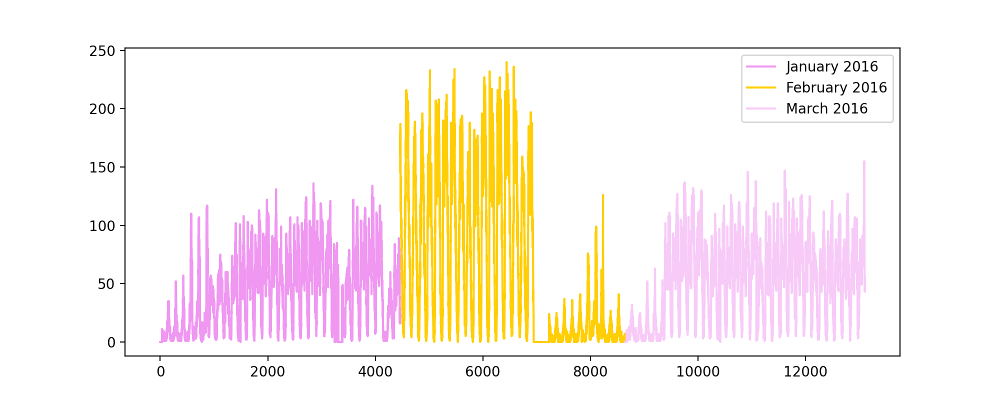

<IPython.core.display.Javascript object>


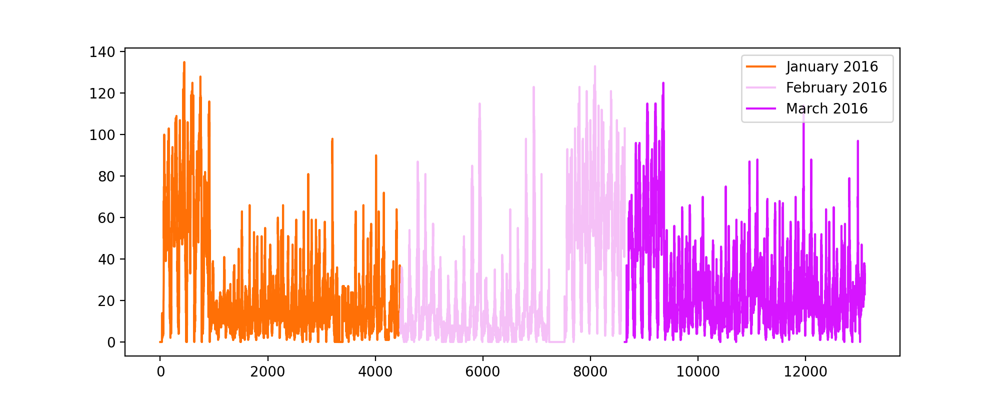

<IPython.core.display.Javascript object>


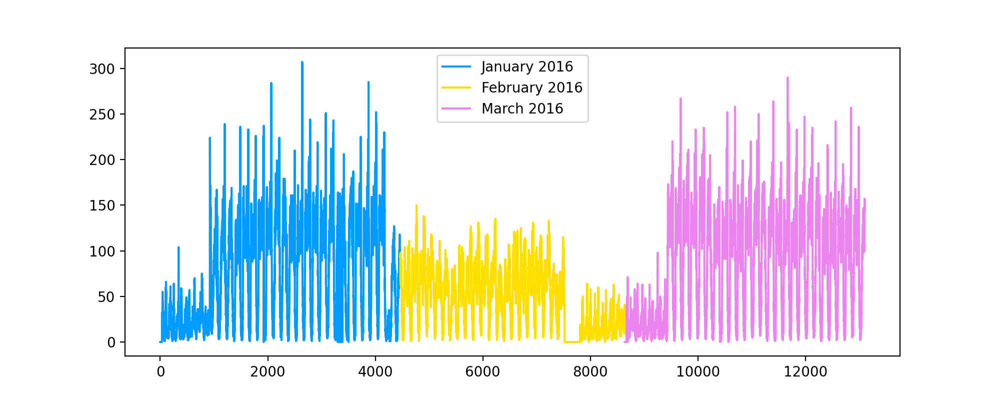

<IPython.core.display.Javascript object>


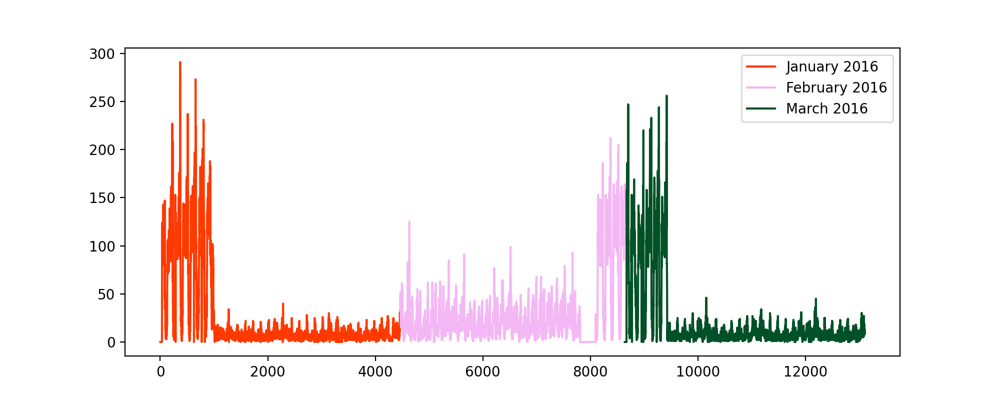

<IPython.core.display.Javascript object>


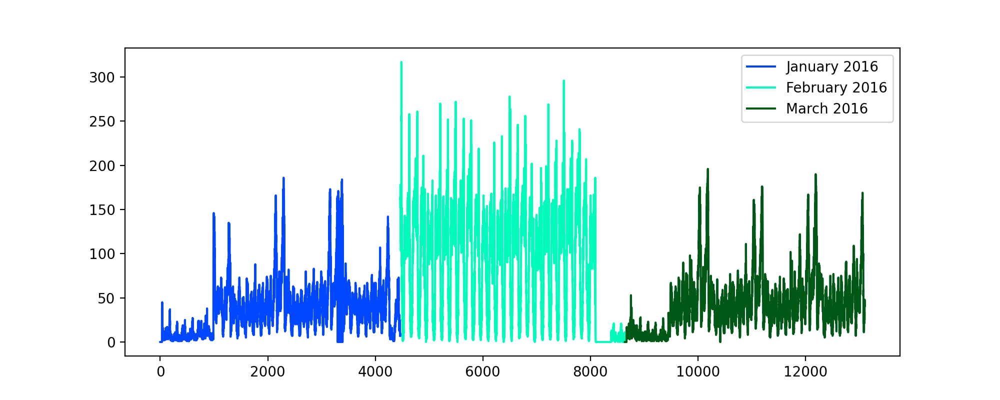

<IPython.core.display.Javascript object>


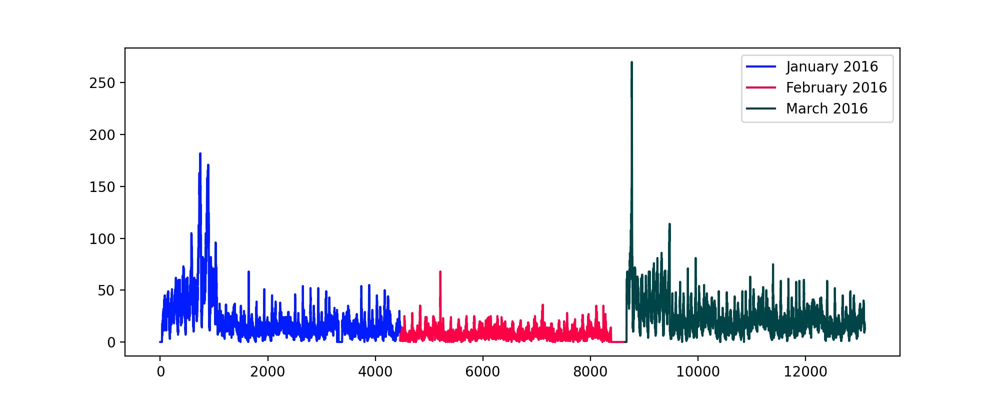

<IPython.core.display.Javascript object>


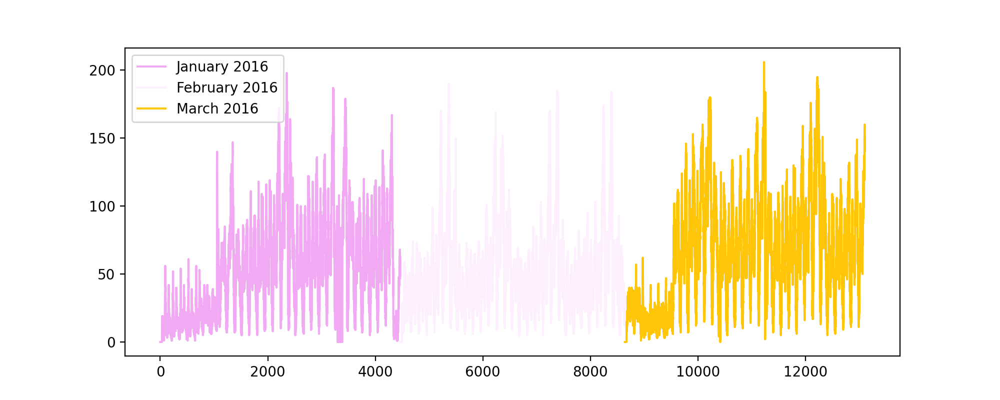

<IPython.core.display.Javascript object>


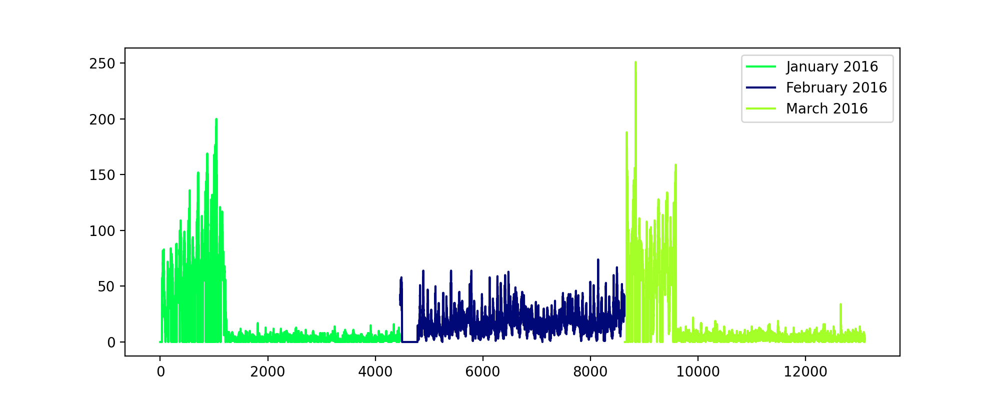

<IPython.core.display.Javascript object>


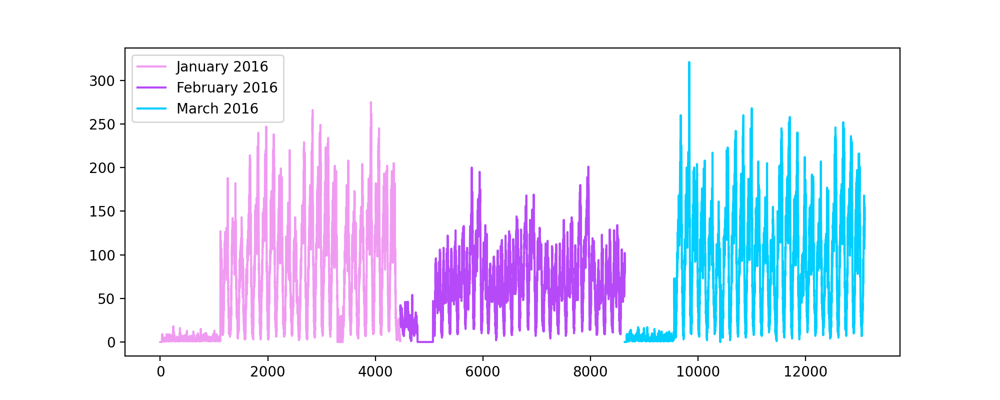

<IPython.core.display.Javascript object>


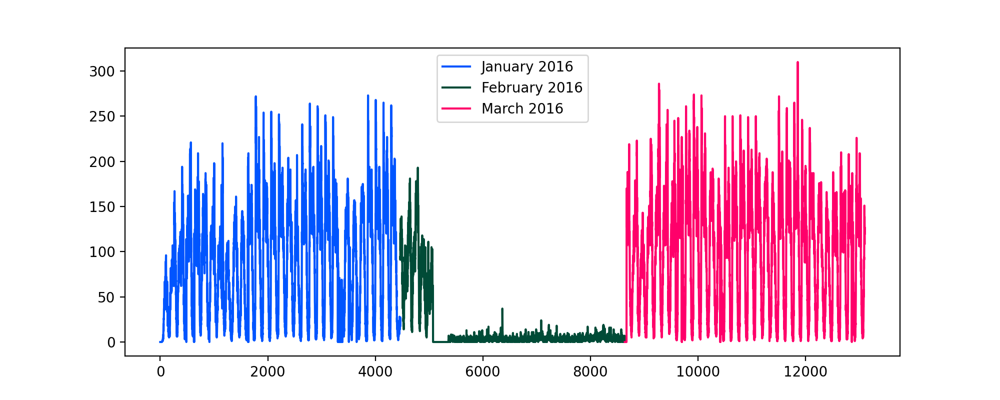

<IPython.core.display.Javascript object>


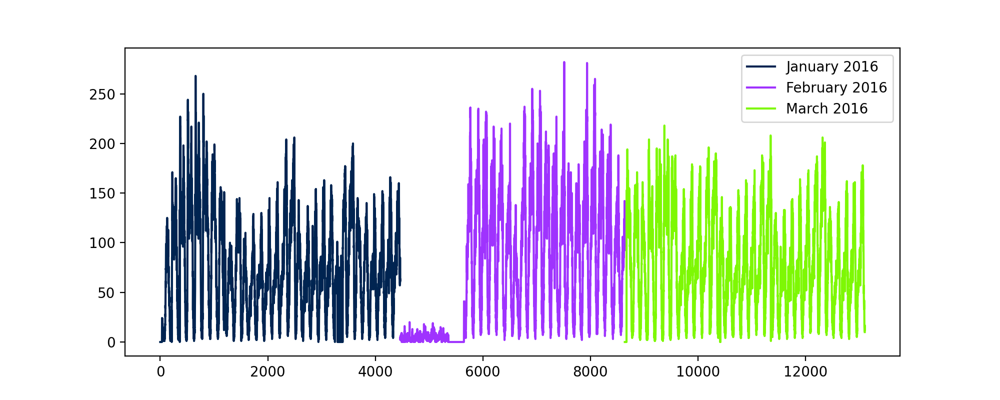

<IPython.core.display.Javascript object>


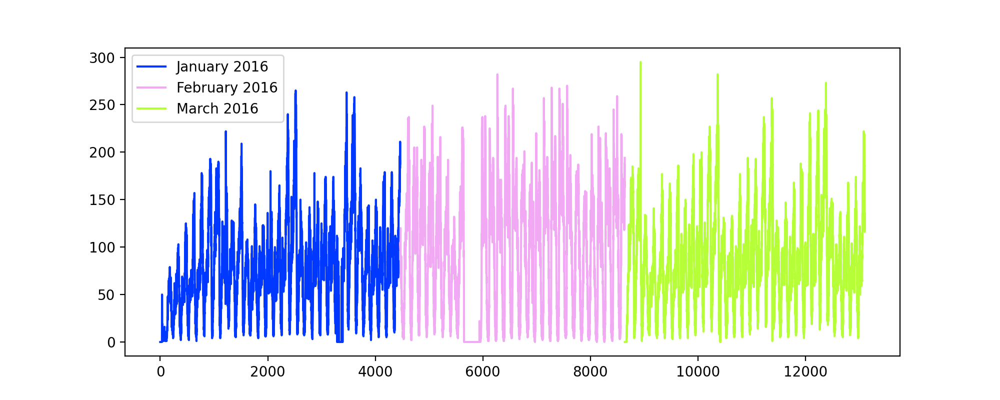

<IPython.core.display.Javascript object>


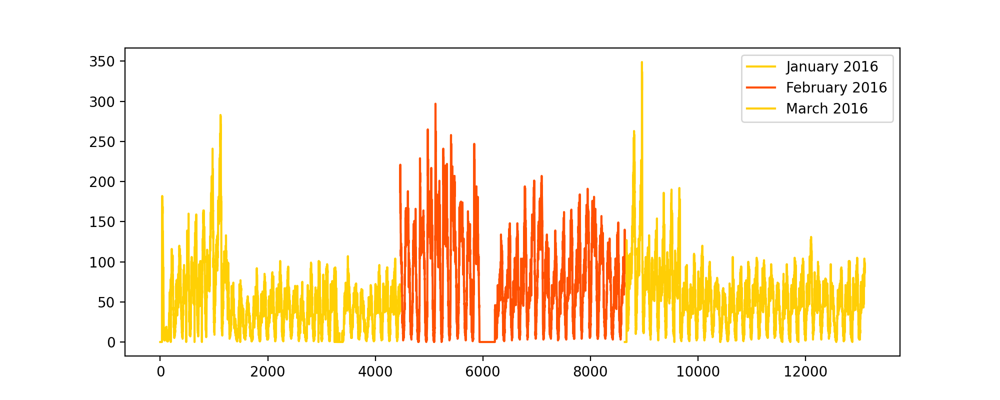

<IPython.core.display.Javascript object>


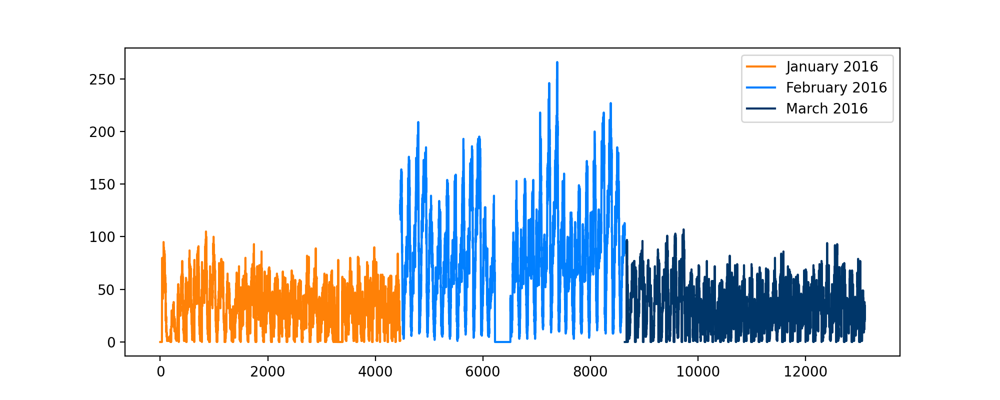

<IPython.core.display.Javascript object>


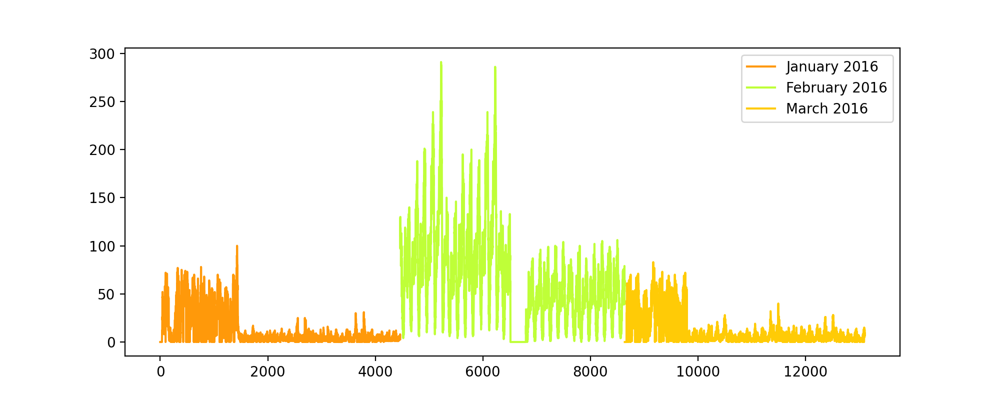

In [64]:
import numpy as np
import matplotlib.pyplot as plt

def generate_random_color():
    # Generate a color using the Gist_NCAR colormap with a random input
    return plt.cm.gist_ncar(np.random.random())

# Define x-axis ranges for the three months
january_range = np.arange(0, 4464)
february_range = np.arange(4464, 8640)
march_range = np.arange(8640, 13104)

# Loop through each region and plot data for January, February, and March 2016
for region_index in range(40):
    plt.figure(figsize=(10, 4))
    
    # Plot the data for January 2016
    plt.plot(january_range, cumulative_regions[region_index][:4464], 
             color=generate_random_color(), label='January 2016')
    
    # Plot the data for February 2016
    plt.plot(february_range, cumulative_regions[region_index][4464:8640], 
             color=generate_random_color(), label='February 2016')
    
    # Plot the data for March 2016
    plt.plot(march_range, cumulative_regions[region_index][8640:], 
             color=generate_random_color(), label='March 2016')
    
    plt.legend()
    plt.show()


<IPython.core.display.Javascript object>


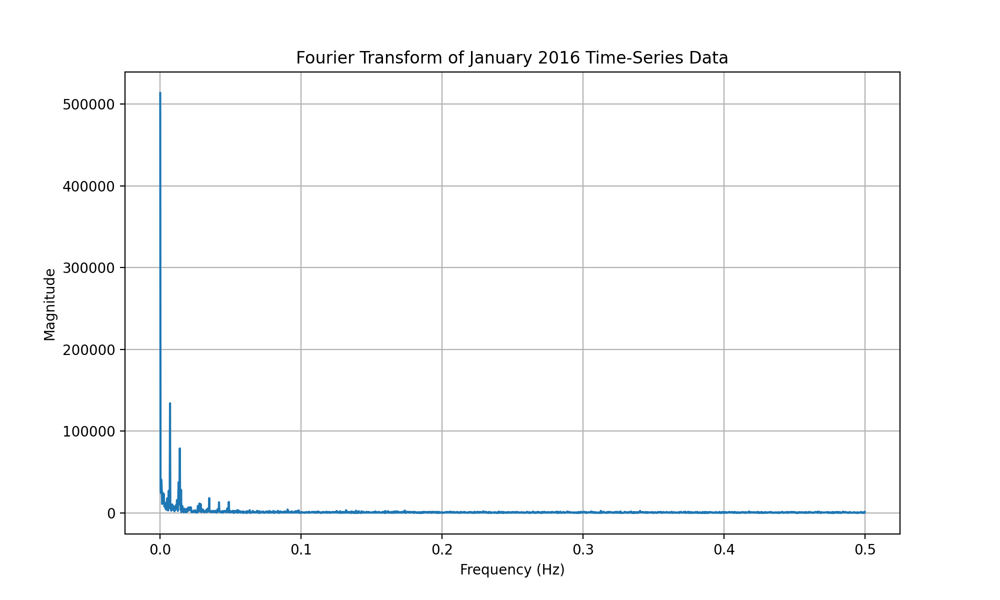

In [65]:
# Reference link on peak detection: https://blog.ytotech.com/2015/11/01/findpeaks-in-python/
# Reference link on Fast Fourier Transform (FFT) : https://docs.scipy.org/doc/numpy/reference/generated/numpy.fft.fft.html

# Fourier Transform on the time-domain signal for January 2016
time_signal = np.array(jan_2016_filled)[0:4460]
fourier_transform = np.fft.fft(time_signal)

#  frequency bins
sampling_interval = 1  # Assumed time interval of 1 unit between samples
frequencies = np.fft.fftfreq(len(time_signal), d=sampling_interval)

# magnitude of the Fourier coefficients
plt.figure(figsize=(10, 6))
plt.plot(frequencies[:len(frequencies)//2], np.abs(fourier_transform)[:len(frequencies)//2])
plt.title("Fourier Transform of January 2016 Time-Series Data")
plt.xlabel("Frequency (Hz)")
plt.ylabel("Magnitude")
plt.grid(True)
plt.show()

In [66]:
#Dataframe only with x(i) values as jan-2015 data and y(i) values as jan-2016
ratios_jan = pd.DataFrame()
ratios_jan['Given']=jan_2015_smoothed
ratios_jan['Prediction']=jan_2016_filled
ratios_jan['Ratios']=ratios_jan['Prediction']*1.0/ratios_jan['Given']*1.0

# Data Modelling: Baseline models

Now we move into modelling in order to anticipate the pickup densities for the months of Jan, Feb and March of 2016 for which we are employing different models with two modifications :

1.Using the 2016 data's ratios to the 2015 data i.e., $ R_t = \frac{P_t^{2016}}{P_t^{2015}} $

2.Using the 2016 data's known values from the past to forecast future values

## Simple Moving Averages

The Moving Averages Model is the first model employed; it forecasts the subsequent value by utilizing the n preceding values.

Employing Ratio Values: $$ R_t = (R_{t-1} + R_{t-2} + R_{t-3} +......+ R_{t-n})/n $$

In [67]:
def moving_average_predictions(ratio_data, month):
    
    current_ratio = ratio_data['Ratios'].iloc[0]
    errors = []
    forecasts = []
    window_size = 3
    ratio_forecast = []

    # Loop over the entire data range (4464 * 40 entries)
    for idx in range(0, 4464 * 40):

        if idx % 4464 == 0:
            ratio_forecast.append(0)
            forecasts.append(0)
            errors.append(0)
            continue

        # Append the predicted ratio to the list
        ratio_forecast.append(current_ratio)

        # Calculate the predicted value using the current ratio
        forecast_value = int(ratio_data['Given'].iloc[idx] * current_ratio)
        forecasts.append(forecast_value)

        # Calculate the absolute error
        prediction_error = abs(forecast_value - ratio_data['Prediction'].iloc[idx])
        errors.append(prediction_error)

        # Update the moving average ratio based on the window size
        if idx + 1 >= window_size:
            current_ratio = ratio_data['Ratios'].iloc[idx + 1 - window_size:idx + 1].mean()
        else:
            current_ratio = ratio_data['Ratios'].iloc[:idx + 1].mean()

    # Store predictions and errors in the DataFrame
    ratio_data['MA_R_Forecast'] = forecasts
    ratio_data['MA_R_Error'] = errors

    # Calculate MAPE and MSE
    mean_absolute_percentage_error = (sum(errors) / len(errors)) / (ratio_data['Prediction'].mean())
    mean_squared_error = sum([err ** 2 for err in errors]) / len(errors)

    return ratio_data, mean_absolute_percentage_error, mean_squared_error

The window-size hyperparameter for the above is manually adjusted, and it is discovered that window-size $n$ of 3 is ideal for obtaining the best results using Moving Averages using prior Ratio values, so we obtain
 $$ R_t = (R_{t-1} + R_{t-2} + R_{t-3} +......+ R_{t-n})/3 $$


Next, we forecast the future value using the Moving Averages of the 2016 values itself.
 $$ P_t = (P_{t-1} + P_{t-2} + P_{t-3} +......+ P_{t-n})/n $$

In [68]:
def moving_average_prediction_calc(ratio_df, month):
    # Initial predicted value is the first prediction in the data
    initial_forecast = ratio_df['Prediction'].iloc[0]
    error_list = []
    forecast_list = []
    window_size = 1
    forecast_ratios = []

    # Loop through the entire dataset (40 clusters * 4464 intervals)
    for index in range(0, 4464 * 40):

        # Append the current forecasted value
        forecast_list.append(initial_forecast)

        # Calculate the absolute error for the current interval
        error_value = abs(initial_forecast - ratio_df['Prediction'].iloc[index])
        error_list.append(error_value)

        # Update the moving average forecast based on the window size
        if index + 1 >= window_size:
            initial_forecast = int(ratio_df['Prediction'].iloc[index + 1 - window_size:index + 1].mean())
        else:
            initial_forecast = int(ratio_df['Prediction'].iloc[:index + 1].mean())

    # Store the calculated forecasts and errors in the DataFrame
    ratio_df['MA_P_Forecast'] = forecast_list
    ratio_df['MA_P_Error'] = error_list

    # Calculate Mean Absolute Percentage Error (MAPE) and Mean Squared Error (MSE)
    mape_error = (sum(error_list) / len(error_list)) / (ratio_df['Prediction'].mean())
    mse_error = sum([error ** 2 for error in error_list]) / len(error_list)

    return ratio_df, mape_error, mse_error

The window-size (n), the hyperparameter for the above, is manually adjusted. It is discovered that the window-size of 1 is ideal for obtaining the best results using Moving Averages utilizing prior 2016 values, so we obtain
$$ P_t = P_{t-1} $$

## Weighted Moving Averages

All of the data in the window were given equal weight by the Moving Averages Model, but we know deep down that the most recent values will probably be more comparable to the future than the earlier values. This analogy is transformed into a mathematical relationship using weighted averages, which assigns the largest weight to the most recent prior value when computing averages for the older values that come after it.

Ratio-valued Weighted Moving Averages -
$$ R_t = (N * R_{t-1} + (N - 2) * R_{t-3}.....1 * R_{t-n}) / (N * (N + 1)/2)$$

In [69]:
def weighted_avg_ratio_forecast(ratio_df, month):
    # Initialize the first predicted ratio from the data
    current_ratio = ratio_df['Ratios'].iloc[0]
    alpha = 0.5  # Weighting factor (not used in the loop)
    error_values = []
    forecasted_values = []
    window_len = 5
    weighted_ratios = []

    # Loop through the entire dataset (40 clusters * 4464 intervals)
    for idx in range(0, 4464 * 40):
        # Reset values for the start of each cluster
        if idx % 4464 == 0:
            weighted_ratios.append(0)
            forecasted_values.append(0)
            error_values.append(0)
            continue

        # Append the current forecasted ratio
        weighted_ratios.append(current_ratio)
        # Forecast the value using the current ratio
        forecast_value = int(ratio_df['Given'].iloc[idx] * current_ratio)
        forecasted_values.append(forecast_value)
        # Calculate the absolute error
        error = abs(forecast_value - ratio_df['Prediction'].iloc[idx])
        error_values.append(error)

        # Update the weighted moving average ratio
        if idx + 1 >= window_len:
            weighted_sum = sum([(window_len - j) * ratio_df['Ratios'].iloc[idx + 1 - window_len + j] for j in range(window_len)])
            total_weights = sum(range(1, window_len + 1))
            current_ratio = weighted_sum / total_weights
        else:
            weighted_sum = sum([(idx + 1 - j) * ratio_df['Ratios'].iloc[j] for j in range(idx + 1)])
            total_weights = sum(range(1, idx + 2))
            current_ratio = weighted_sum / total_weights
            
    # Store the forecasted values and errors in the DataFrame
    ratio_df['WA_R_Forecast'] = forecasted_values
    ratio_df['WA_R_Error'] = error_values

    # Calculate Mean Absolute Percentage Error (MAPE) and Mean Squared Error (MSE)
    mape_error = sum(error_values) / len(error_values) / ratio_df['Prediction'].mean()
    mse_error = sum([err ** 2 for err in error_values]) / len(error_values)

    return ratio_df, mape_error, mse_error

The window-size $n$, the hyperparameter for the above, is manually adjusted. It is discovered that a window-size of 5 is ideal for obtaining the best results when utilizing Weighted Moving Averages with prior Ratio values, so we obtain 
$$ R_t = (5 * R_{t-1} + 5 * R_{t-2} + 5 * R_{t-3} + 5 * R_{t-4} + 5 * R_{t-5})/15 $$

Calculating Weighted Moving Averages using Historical 2016 Values-
$$ P_t = (N * P_{t-1} + (N - 2) * P_{t-3}.....1 * P_{t-n}) / (N * (N + 1)/2)$$

In [70]:
def weighted_avg_prediction_forecast(ratios_df, month):
    # Initialize the first predicted value
    current_forecast = ratios_df['Prediction'].iloc[0]
    errors = []
    forecast_values = []
    window_len = 2

    # Loop through each time point across all clusters
    for idx in range(4464 * 40):
        # Record the current forecasted value
        forecast_values.append(current_forecast)
        # Calculate the absolute error
        errors.append(abs(current_forecast - ratios_df['Prediction'].iloc[idx]))

        # Update the weighted average forecast value
        if idx + 1 >= window_len:
            weighted_sum = sum([(window_len - j) * ratios_df['Prediction'].iloc[idx + 1 - window_len + j] for j in range(window_len)])
            total_weights = sum(range(1, window_len + 1))
            current_forecast = int(weighted_sum / total_weights)
        else:
            weighted_sum = sum([(idx + 1 - j) * ratios_df['Prediction'].iloc[j] for j in range(idx + 1)])
            total_weights = sum(range(1, idx + 2))
            current_forecast = int(weighted_sum / total_weights)

    # Store the forecasted values and errors in the DataFrame
    ratios_df['Weighted_Forecast'] = forecast_values
    ratios_df['Weighted_Error'] = errors

    # Calculate Mean Absolute Percentage Error (MAPE) and Mean Squared Error (MSE)
    mape_error = sum(errors) / len(errors) / ratios_df['Prediction'].mean()
    mse_error = sum([e**2 for e in errors]) / len(errors)

    return ratios_df, mape_error, mse_error

The window-size (n), the hyperparameter for the above, is manually adjusted. It is discovered that window-size of 2 is ideal for obtaining the best results using Weighted Moving Averages utilizing prior 2016 values, so we get 
$$ P_t = (2 * P_{t-1} + P_{t-2})/3 $$

## Exponential Weighted Moving Averages

We have satisfied the analogy of assigning greater weights to the most recent value and decreasing weights to the values that come after it with weighted averages, but we are still unsure of the best weighting scheme because there are countless ways to adjust the hyperparameter window-size and assign weights in a non-increasing order. Exponential Moving Averages, a more sensible method of allocating weights and simultaneously employing an ideal window-size, are used to streamline this procedure.

We utilize a single hyperparameter, alpha ($\alpha$) in exponential moving averages, and we configure the weights and window sizes based on its value. Alpha is a number between 0 and 1.
For instance. If $\alpha$ = 0.9, then the current iteration's value is based on the number of days that is
$$ \frac{1}{1 - \alpha} = 10 $$ i.e., we forecast the value for the current iteration after taking values into account 10 days earlier. Additionally, the weights are determined by $$ \frac{2}{N + 1} = 10 $$ where N is the total number of previous values taken into account.

This suggests that the weight of the first or latest value is 0.18, and that the weights of the succeeding values decrease exponentially after that.
$$
R'_t = \alpha * R_{t-1} + (1 - \alpha) * R'_{t-1}
$$


In [71]:
def exp_avg_ratio_predictions(ratios_df, month):
    # Initialize the first predicted ratio
    current_ratio = ratios_df['Ratios'].iloc[0]
    alpha = 0.6  # Smoothing factor
    errors = []
    forecasted_values = []
    ratio_forecasts = []

    # Loop through each data point for all clusters
    for idx in range(4464 * 40):

        # Reset at the start of each new cluster
        if idx % 4464 == 0:
            ratio_forecasts.append(0)
            forecasted_values.append(0)
            errors.append(0)
            continue

        # Append the current ratio to the forecasted ratios list
        ratio_forecasts.append(current_ratio)
        # Compute and store the predicted value
        forecasted_value = int(ratios_df['Given'].iloc[idx] * current_ratio)
        forecasted_values.append(forecasted_value)
        # Calculate and store the absolute error
        errors.append(abs(forecasted_value - ratios_df['Prediction'].iloc[idx]))

        # Update the ratio using exponential averaging
        current_ratio = (alpha * current_ratio) + (1 - alpha) * ratios_df['Ratios'].iloc[idx]

    # Store the predictions and errors in the DataFrame
    ratios_df['Exp_Avg_R1_Predicted'] = forecasted_values
    ratios_df['Exp_Avg_R1_Error'] = errors

    # Calculate Mean Absolute Percentage Error (MAPE) and Mean Squared Error (MSE)
    mape_error = sum(errors) / len(errors) / ratios_df['Prediction'].mean()
    mse_error = sum([e**2 for e in errors]) / len(errors)

    return ratios_df, mape_error, mse_error

$$
P'_t = \alpha * P_{t-1} + (1 - \alpha) * P'_{t-1}
$$


In [72]:
def exp_avg_prediction_forecast(ratios_df, month):
    # Initialize the first predicted value
    current_prediction = ratios_df['Prediction'].iloc[0]
    smoothing_factor = 0.3
    forecast_errors = []
    predictions = []

    # Iterate through each data point across all clusters
    for index in range(4464 * 40):

        # Handle the start of each new cluster
        if index % 4464 == 0:
            predictions.append(0)
            forecast_errors.append(0)
            continue

        # Append the current predicted value to the list of predictions
        predictions.append(current_prediction)
        # Calculate and record the absolute error for the current prediction
        forecast_errors.append(abs(current_prediction - ratios_df['Prediction'].iloc[index]))

        # Update the prediction using exponential smoothing
        current_prediction = int(smoothing_factor * current_prediction + (1 - smoothing_factor) * ratios_df['Prediction'].iloc[index])

    # Store the predictions and errors back into the DataFrame
    ratios_df['Exp_Avg_P1_Predicted'] = predictions
    ratios_df['Exp_Avg_P1_Error'] = forecast_errors

    # Compute Mean Absolute Percentage Error (MAPE) and Mean Squared Error (MSE)
    mape_error = sum(forecast_errors) / len(forecast_errors) / ratios_df['Prediction'].mean()
    mse_error = sum([err ** 2 for err in forecast_errors]) / len(forecast_errors)

    return ratios_df, mape_error, mse_error

In [73]:
# Initialize lists to store error metrics
mean_errors = [0] * 10
median_errors = [0] * 10

# prediction methods for January data and store errors
ratios_jan, mean_errors[0], median_errors[0] = moving_average_predictions(ratios_jan, 'January')
ratios_jan, mean_errors[1], median_errors[1] = moving_average_prediction_calc(ratios_jan, 'January')
ratios_jan, mean_errors[2], median_errors[2] = weighted_avg_ratio_forecast(ratios_jan, 'January')
ratios_jan, mean_errors[3], median_errors[3] = weighted_avg_prediction_forecast(ratios_jan, 'January')
ratios_jan, mean_errors[4], median_errors[4] = exp_avg_ratio_predictions(ratios_jan, 'January')
ratios_jan, mean_errors[5], median_errors[5] = exp_avg_prediction_forecast(ratios_jan, 'January')

## Comparison between baseline models

In order to compare the performance of our forecasting model across models, we have selected MAPE (Mean Absolute Percentage Error) as our error metric. We also use MSE (Mean Squared Error) to gain a better understanding of how well our forecasting model handles outliers, ensuring that there is not a significant error margin between our prediction and the actual value.

In [74]:
# Display the error metrics for different forecasting methods
print("Error Metric Matrix (Forecasting Methods) - MAPE & MSE")
print("=" * 100)

# Moving Averages
print("1. Moving Averages (Ratios) -".ljust(55), "MAPE:", mean_errors[0], "\tMSE:", median_errors[0])
print("2. Moving Averages (2016 Values) -".ljust(55), "MAPE:", mean_errors[1], "\tMSE:", median_errors[1])

print("=" * 100)

# Weighted Moving Averages
print("3. Weighted Moving Averages (Ratios) -".ljust(55), "MAPE:", mean_errors[2], "\tMSE:", median_errors[2])
print("4. Weighted Moving Averages (2016 Values) -".ljust(55), "MAPE:", mean_errors[3], "\tMSE:", median_errors[3])

print("=" * 100)

# Exponential Moving Averages
print("5. Exponential Moving Averages (Ratios) -".ljust(55), "MAPE:", mean_errors[4], "\tMSE:", median_errors[4])
print("6. Exponential Moving Averages (2016 Values) -".ljust(55), "MAPE:", mean_errors[5], "\tMSE:", median_errors[5])

Error Metric Matrix (Forecasting Methods) - MAPE & MSE
1. Moving Averages (Ratios) -                           MAPE: 0.22520755864692715 	MSE: 1256.1530129928315
2. Moving Averages (2016 Values) -                      MAPE: 0.15581858062497916 	MSE: 252.88880488351253
3. Weighted Moving Averages (Ratios) -                  MAPE: 0.2603569894578971 	MSE: 1626.1082605286738
4. Weighted Moving Averages (2016 Values) -             MAPE: 0.15687836625093146 	MSE: 253.8498039874552
5. Exponential Moving Averages (Ratios) -               MAPE: 0.2252223696085859 	MSE: 1088.8152385752687
6. Exponential Moving Averages (2016 Values) -          MAPE: 0.14758132750932357 	MSE: 222.32303987455197


Note that just January 2015 and January 2016 are used in the comparisons above.

The aforementioned matrix suggests that the following would be the most accurate forecasting model for our prediction:
$$
P'_t = \alpha * P_{t-1} + (1 - \alpha) * P'_{t-1}
$$

For example, Exponential Moving Averages with 2016 Data

## Regression Models

#### Train-test Split

Divided the three months of 2016 pickup data into 70% train and 30% test data for each region, arranged date-wise, before I begin making predictions using the tree-based regression models.

In [76]:
#24*31*60/10 = 4464 is the number of 10-minute indexes for January 2015.
#24*31*60/10 = 4464 is the number of 10-minute indices for January 2016.
#The 10 minute index numbers for February 2016 are 24*29*60/10 = 4176, while March 2016 are 24*31*60/10 = 4464.
#cumulative_regions : it will have 40 lists, each of which will have 4464 + 4176 + 4464 numbers, 
#which indicate how many pickups 
#occurred in each of the 40 NYC clusters/regions during the course of three months in 2016.
month_jan_2016 = dd.read_csv('/Users/rolex/Desktop/Dissertation/Data/yellow_tripdata_2016-01.csv.zip')
month_feb_2016 = dd.read_csv('/Users/rolex/Desktop/Dissertation/Data/yellow_tripdata_2016-02.csv.zip')
month_mar_2016 = dd.read_csv('/Users/rolex/Desktop/Dissertation/Data/yellow_tripdata_2016-03.csv.zip')


my_data_frame = month_jan_2016[['pickup_latitude', 'pickup_longitude']].compute()
kmeans = KMeans(n_clusters=40, random_state=0).fit(my_data_frame)

# Preparing data for train-test split
num_intervals = 5
output_values = []
latitude_repeated = []
longitude_repeated = []
weekday_coding = []
input_features = [0] * num_intervals

#  `pickup_data` for demonstration purposes 
# `pickup_data` is a list of 40 lists, each containing time-binned pickup counts
pickup_data = np.random.randint(0, 100, (40, 4464+4176+4464)).tolist()

# Loop over each cluster (total of 40)
for cluster in range(40):
    # Append the latitude for the cluster center repeated 13099 times
    latitude_repeated.append([kmeans.cluster_centers_[cluster][0]] * 13099)
    
    # Append the longitude for the cluster center repeated 13099 times
    longitude_repeated.append([kmeans.cluster_centers_[cluster][1]] * 13099)

    # weekday coding
    weekday_coding.append([int(((k // 144) % 7 + 4) % 7) for k in range(5, 4464 + 4176 + 4464)])

    # Stacking features in a rolling window fashion, considering the last 5 intervals
    input_features = np.vstack((input_features, [pickup_data[cluster][r:r + num_intervals] 
                                                 for r in range(len(pickup_data[cluster]) - num_intervals)]))
    
    # pickups from the 6th interval onward as the output
    output_values.append(pickup_data[cluster][num_intervals:])

# Remove the initial zero row from the input features
input_features = input_features[1:]

# Verification step to ensure data consistency
is_consistent = (len(latitude_repeated[0]) * len(latitude_repeated) == input_features.shape[0] == 
                 len(weekday_coding) * len(weekday_coding[0]) == 40 * 13099 == len(output_values) * len(output_values[0]))

print(is_consistent)

True


In [77]:
# smoothing factor for the exponential moving average (EMA)
alpha = 0.3

ema_predictions = []

# List of lists to store EMA values after the 5th interval for each cluster
ema_feature_list = []

# hold flattened EMA values for t-SNE
flattened_ema_values = []

# Loop through each of the 40 clusters
for cluster_index in range(40):
    
    # list to hold EMA values for the current cluster
    cluster_ema_values = []
    
    # Loop through each of the 13104 time intervals for the current cluster
    for time_index in range(13104):
        
        # first interval, set the EMA value to the actual value and skip to the next iteration
        if time_index == 0:
            current_ema = cumulative_regions[cluster_index][0]
            cluster_ema_values.append(0)
            continue
        
        cluster_ema_values.append(current_ema)
        
        # new EMA value based on the formula
        current_ema = int((alpha * current_ema) + (1 - alpha) * cumulative_regions[cluster_index][time_index])
    
    # calculating EMA for all intervals, store the values from the 6th interval onward
    ema_feature_list.append(cluster_ema_values[5:])
    
    # Reset the cluster EMA values list for the next cluster
    cluster_ema_values = []

In [78]:
# number of data points for training and testing sets
total_samples = 13099
train_size = int(total_samples * 0.7)
test_size = total_samples - train_size

# Print the sizes of the train and test datasets
print("Number of samples in the training set:", train_size)
print("Number of samples in the testing set:", test_size)

Number of samples in the training set: 9169
Number of samples in the testing set: 3930


In [79]:
# split point
split_index = 9169

# training data, which includes the first 70% of the timestamps for each cluster
train_features = []
for i in range(40):
    start = i * 13099
    end = start + split_index
    train_features.append(input_features[start:end])

# testing data, which includes the remaining 30% of the timestamps for each cluster
test_features = []
for i in range(40):
    start = i * 13099 + split_index
    end = (i + 1) * 13099
    test_features.append(input_features[start:end])

In [80]:
# Print the details for the training data
num_clusters_train = len(train_features)
num_points_train = len(train_features[0])
num_features_train = len(train_features[0][0])

print(f"Training Data Summary:")
print(f"  Number of clusters: {num_clusters_train}")
print(f"  Number of data points per cluster: {num_points_train}")
print(f"  Number of features per data point: {num_features_train}")

# Print the details for the testing data
num_clusters_test = len(test_features)
num_points_test = len(test_features[0])
num_features_test = len(test_features[0][0])

print(f"Testing Data Summary:")
print(f"  Number of clusters: {num_clusters_test}")
print(f"  Number of data points per cluster: {num_points_test}")
print(f"  Number of features per data point: {num_features_test}")

Training Data Summary:
  Number of clusters: 40
  Number of data points per cluster: 9169
  Number of features per data point: 5
Testing Data Summary:
  Number of clusters: 40
  Number of data points per cluster: 3930
  Number of features per data point: 5


In [81]:
# number of timestamps to extract
num_train_timestamps = 9169

# first 9169 timestamps for each feature set
train_latitudes = [data[:num_train_timestamps] for data in latitude_repeated]
train_longitudes = [data[:num_train_timestamps] for data in longitude_repeated]
train_weekdays = [data[:num_train_timestamps] for data in weekday_coding]
train_outputs = [data[:num_train_timestamps] for data in output_values]
train_exp_avg = [data[:num_train_timestamps] for data in ema_feature_list]

In [82]:
# start the test data extraction
start_test_index = 9169

# remaining timestamps for each feature set
test_latitudes = [data[start_test_index:] for data in latitude_repeated]
test_longitudes = [data[start_test_index:] for data in longitude_repeated]
test_weekdays = [data[start_test_index:] for data in weekday_coding]
test_outputs = [data[start_test_index:] for data in output_values]
test_exp_avg = [data[start_test_index:] for data in ema_feature_list]

In [83]:
# Flatten the list of lists for training features
train_new_features = [item for sublist in train_features for item in sublist]

# Flatten the list of lists for test features
test_new_features = [item for sublist in test_features for item in sublist]

In [84]:
# Flatten lists using list comprehensions
tsne_train_lat = [item for sublist in train_latitudes for item in sublist]
tsne_train_lon = [item for sublist in train_longitudes for item in sublist]
tsne_train_weekday = [item for sublist in train_weekdays for item in sublist]
tsne_train_output = [item for sublist in train_outputs for item in sublist]
tsne_train_exp_avg = [item for sublist in train_exp_avg for item in sublist]

In [85]:
# Flatten lists using list comprehensions
tsne_test_lat = [item for sublist in test_latitudes for item in sublist]
tsne_test_lon = [item for sublist in test_longitudes for item in sublist]
tsne_test_weekday = [item for sublist in test_weekdays for item in sublist]
tsne_test_output = [item for sublist in test_outputs for item in sublist]
tsne_test_exp_avg = [item for sublist in test_exp_avg for item in sublist]

In [86]:
def create_dataframe(features, lat, lon, weekday, exp_avg):
    # Convert lists to Series
    df_features = pd.DataFrame(features, columns=['ft_5', 'ft_4', 'ft_3', 'ft_2', 'ft_1'])
    df_lat = pd.Series(lat, name='lat')
    df_lon = pd.Series(lon, name='lon')
    df_weekday = pd.Series(weekday, name='weekday')
    df_exp_avg = pd.Series(exp_avg, name='exp_avg')

    # Combine all Series into a DataFrame
    df_combined = pd.concat([df_features, df_lat, df_lon, df_weekday, df_exp_avg], axis=1)
    return df_combined

df_train = create_dataframe(train_new_features, tsne_train_lat, tsne_train_lon, tsne_train_weekday, tsne_train_exp_avg)

print(df_train.shape)

(366760, 9)


In [87]:
# Function to create a DataFrame from separate lists and Series
def create_test_dataframe(features, lat, lon, weekday, exp_avg):
    # Convert lists to Series
    df_features = pd.DataFrame(features, columns=['ft_5', 'ft_4', 'ft_3', 'ft_2', 'ft_1'])
    df_lat = pd.Series(lat, name='lat')
    df_lon = pd.Series(lon, name='lon')
    df_weekday = pd.Series(weekday, name='weekday')
    df_exp_avg = pd.Series(exp_avg, name='exp_avg')

    # Combine all Series into a DataFrame
    df_combined = pd.concat([df_features, df_lat, df_lon, df_weekday, df_exp_avg], axis=1)
    return df_combined

df_test = create_test_dataframe(test_new_features, tsne_test_lat, tsne_test_lon, tsne_test_weekday, tsne_test_exp_avg)

print(df_test.shape)

(157200, 9)


In [88]:
df_test.head()

,ft_5,ft_4,ft_3,ft_2,ft_1,lat,lon,weekday,exp_avg
0,21,13,31,35,12,40.794689,-73.969177,4,147
1,13,31,35,12,3,40.794689,-73.969177,4,155
2,31,35,12,3,37,40.794689,-73.969177,4,165
3,35,12,3,37,33,40.794689,-73.969177,4,185
4,12,3,37,33,15,40.794689,-73.969177,4,168


### Linear Regression

In [89]:
from sklearn.linear_model import LinearRegression

# Linear Regression model
linear_reg = LinearRegression()

# Fit the model on the training data
linear_reg.fit(df_train, tsne_train_output)

# Predict on the test data
predicted_values_test = linear_reg.predict(df_test)
rounded_predictions_test = [round(value) for value in predicted_values_test]

# Predict on the training data
predicted_values_train = linear_reg.predict(df_train)
rounded_predictions_train = [round(value) for value in predicted_values_train]

### Random Forest Regressor

In [90]:
from sklearn.ensemble import RandomForestRegressor

# RandomForestRegressor model with specified parameters
rf_regressor = RandomForestRegressor(
    max_features='sqrt',       # square root of the number of features
    min_samples_leaf=4,        # Minimum number of samples required to be at a leaf node
    min_samples_split=3,       # Minimum number of samples required to split an internal node
    n_estimators=40,           # Number of trees in the forest
    n_jobs=-1                  # all available cores for parallel processing
)

rf_regressor.fit(df_train, tsne_train_output)

RandomForestRegressor(max_features='sqrt', min_samples_leaf=4,
                      min_samples_split=3, n_estimators=40, n_jobs=-1)

In [91]:
# RandomForestRegressor to make predictions on the test dataset
test_predictions = rf_regressor.predict(df_test)
rounded_test_predictions = [round(pred) for pred in test_predictions]

# predictions on the training dataset
train_predictions = rf_regressor.predict(df_train)
rounded_train_predictions = [round(pred) for pred in train_predictions]

In [92]:
# column names from the training data
feature_names = df_train.columns
print("Feature Names:")
print(feature_names)

# feature importances from the trained RandomForestRegressor
importances = rf_regressor.feature_importances_
print("Feature Importances:")
print(importances)


Feature Names:
Index(['ft_5', 'ft_4', 'ft_3', 'ft_2', 'ft_1', 'lat', 'lon', 'weekday',
       'exp_avg'],
      dtype='object')
Feature Importances:
[0.13558549 0.13347963 0.13239777 0.1328362  0.13305839 0.06899195
 0.06941547 0.05593695 0.13829814]


### XGBoost Regressor

In [93]:
import xgboost as xgb

# XGBoost Regressor with specific hyperparameters
xgb_regressor = xgb.XGBRegressor(
    learning_rate=0.1,
    n_estimators=1000,
    max_depth=3,
    min_child_weight=3,
    gamma=0,
    subsample=0.8,
    reg_alpha=200,
    reg_lambda=200,
    colsample_bytree=0.8,
    n_jobs=4  # Updated parameter name from nthread to n_jobs
)

# XGBoost model on the training data
xgb_regressor.fit(df_train, tsne_train_output)

XGBRegressor(base_score=None, booster=None, callbacks=None,
             colsample_bylevel=None, colsample_bynode=None,
             colsample_bytree=0.8, device=None, early_stopping_rounds=None,
             enable_categorical=False, eval_metric=None, feature_types=None,
             gamma=0, grow_policy=None, importance_type=None,
             interaction_constraints=None, learning_rate=0.1, max_bin=None,
             max_cat_threshold=None, max_cat_to_onehot=None,
             max_delta_step=None, max_depth=3, max_leaves=None,
             min_child_weight=3, missing=nan, monotone_constraints=None,
             multi_strategy=None, n_estimators=1000, n_jobs=4,
             num_parallel_tree=None, random_state=None, ...)

In [94]:
# Making predictions with the tuned XGBoost regressor
# The model `xgb_regressor` has been tuned with optimal parameters

# Predicting on the test dataset
test_predictions_raw = xgb_regressor.predict(df_test)
xgb_test_preds_rounded = [round(pred) for pred in test_predictions_raw]

# Predicting on the training dataset
train_predictions_raw = xgb_regressor.predict(df_train)
xgb_train_preds_rounded = [round(pred) for pred in train_predictions_raw]

# Calculating the Error metric values for various models

In [95]:
from sklearn.metrics import mean_absolute_error

def calculate_mape(true_values, predicted_values):
    """Calculate Mean Absolute Percentage Error."""
    mean_absolute_error_value = mean_absolute_error(true_values, predicted_values)
    return mean_absolute_error_value / (sum(true_values) / len(true_values))

# Initialize lists to store MAPE values
train_mape = []
test_mape = []

# Calculate MAPE for training data
train_mape.append(calculate_mape(tsne_train_output, df_train['ft_1'].values))
train_mape.append(calculate_mape(tsne_train_output, df_train['exp_avg'].values))
train_mape.append(calculate_mape(tsne_train_output, rounded_train_predictions))
train_mape.append(calculate_mape(tsne_train_output, xgb_train_preds_rounded))
train_mape.append(calculate_mape(tsne_train_output, rounded_predictions_train))

# Calculate MAPE for testing data
test_mape.append(calculate_mape(tsne_test_output, df_test['ft_1'].values))
test_mape.append(calculate_mape(tsne_test_output, df_test['exp_avg'].values))
test_mape.append(calculate_mape(tsne_test_output, rounded_test_predictions))
test_mape.append(calculate_mape(tsne_test_output, xgb_test_preds_rounded))
test_mape.append(calculate_mape(tsne_test_output, rounded_predictions_test))

print("Training MAPE values:", train_mape)
print("Testing MAPE values:", test_mape)

Training MAPE values: [0.672136151950639, 1.0885789216661939, 0.3420580303908324, 0.501775910324675, 0.5040899769611633]
Testing MAPE values: [0.6758303995850754, 1.1164343424757774, 0.5104227520402109, 0.5073623228564795, 0.5071157425010923]


In [96]:
# function to print the MAPE results for different models
def print_error_metrics(train_mape, test_mape):
    print("Error Metric Summary (Tree-Based Regression Methods) - MAPE")
    print("-------------------------------------------------------------")
    models = [
        "Baseline Model",
        "Exponential Averages Forecasting",
        "Linear Regression",
        "Random Forest Regression"
    ]
    
    for i, model in enumerate(models):
        print(f"{model:<40} Train: {train_mape[i]:.4f}     Test: {test_mape[i]:.4f}")

print_error_metrics(train_mape, test_mape)

Error Metric Summary (Tree-Based Regression Methods) - MAPE
-------------------------------------------------------------
Baseline Model                           Train: 0.6721     Test: 0.6758
Exponential Averages Forecasting         Train: 1.0886     Test: 1.1164
Linear Regression                        Train: 0.3421     Test: 0.5104
Random Forest Regression                 Train: 0.5018     Test: 0.5074


# Error Metric Matrix

In [97]:
# function to display MAPE metrics for different models
def display_error_metrics(train_errors, test_errors, models):
    print("Error Metric Summary (Tree-Based Regression Methods) - MAPE")
    print("-------------------------------------------------------------")
    
    for model, train_error, test_error in zip(models, train_errors, test_errors):
        print(f"{model:<35} Train: {train_error:.4f}   Test: {test_error:.4f}")
    
    print("-------------------------------------------------------------")

model_names = [
    "Baseline Model",
    "Exponential Averages Forecasting",
    "Linear Regression",
    "Random Forest Regression",
    "XGBoost Regression"
]

display_error_metrics(train_mape, test_mape, model_names)

Error Metric Summary (Tree-Based Regression Methods) - MAPE
-------------------------------------------------------------
Baseline Model                      Train: 0.6721   Test: 0.6758
Exponential Averages Forecasting    Train: 1.0886   Test: 1.1164
Linear Regression                   Train: 0.3421   Test: 0.5104
Random Forest Regression            Train: 0.5018   Test: 0.5074
XGBoost Regression                  Train: 0.5041   Test: 0.5071
-------------------------------------------------------------
